#1

In [1]:
import cv2 
import numpy as np
from matplotlib import pyplot as plt
import matplotlib as mpl


In [2]:
img = cv2.imread('/home/n/images/peppers.jpg')
cv_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
imgc = cv2.imread('/home/n/images/coins.jpg')
cv_rgbc = cv2.cvtColor(imgc, cv2.COLOR_BGR2RGB)

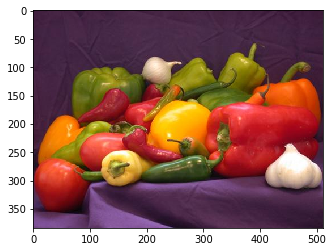

In [3]:
plt.imshow(cv_rgb)

In [4]:
import numpy as np
import scipy.stats as st



In [42]:
def spatial_1(img,filter_):
    HH,WW = filter_.shape
    H,W = img.shape
    Ph = np.int(np.floor(HH/2.))
    Pw = np.int(np.floor(WW/2.))
    pad_x = np.pad(img, ((Ph,), (Pw,)), 'constant')
    h = int(1 + (H + 2 * Ph - HH) / 1)
    wi = int(1 + (W + 2 * Pw - WW) / 1)

    out = np.zeros((h, wi))

    # for n in range(N):
    for g in range(h):
        for t in range(wi):
            out[g, t] = np.sum(pad_x[g:g + HH, t:t + WW] * filter_)
            
    return out


In [43]:
def gkern(l=3, sig=1.):
    """
    creates gaussian kernel with side length l and a sigma of sig
    """

    ax = np.arange(-l // 2 + 1., l // 2 + 1.)
    xx, yy = np.meshgrid(ax, ax)

    kernel = np.exp(-(xx**2 + yy**2) / (2. * sig**2))

    return kernel / np.sum(kernel)

In [44]:
d = np.array([1,0,-1]).reshape((3,1))

In [45]:
f = gkern(5,2)

In [46]:
def get_grad(I,k,sigma):
    f = gkern(k,sigma)
    d = np.array([1,0,-1]).reshape((3,1))
    fx = spatial_1(f,d)*-1
    k = spatial_1(I[:,:,0],fx)*-1
    k2 = spatial_1(I[:,:,0],fx.T)*-1
    M = np.sqrt(k**2 + k2**2)
    M = M/M.max()
    theta = np.arctan2(fx.T, fx)*(180/np.pi)
    angle_i = spatial_1(M,theta)*-1
    return M,angle_i

    

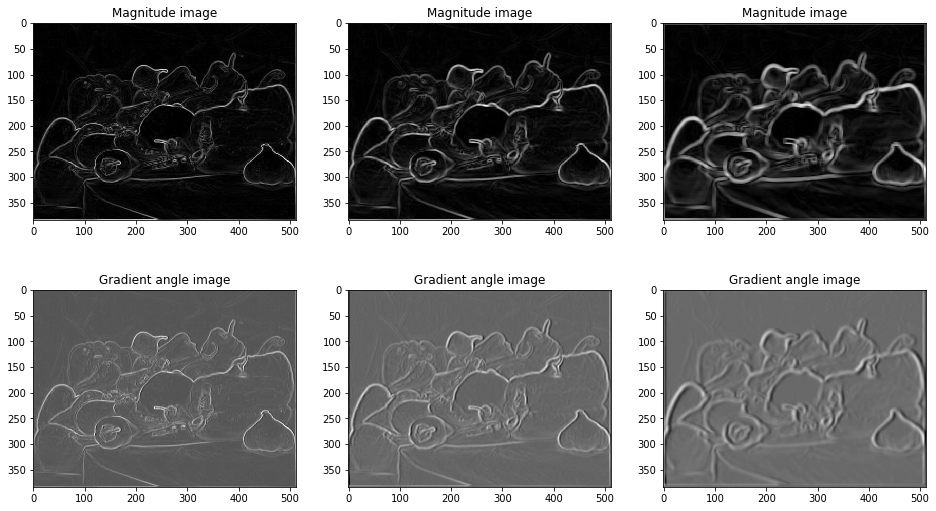

In [47]:
figure = plt.figure(figsize=(16,9))
plt.subplot(2,3,1)
mag,angle =get_grad(cv_rgb,3,9)
plt.imshow(mag,cmap='gray')
plt.title('Magnitude image')
plt.subplot(2,3,4)
plt.imshow(angle,cmap='gray')
plt.title('Gradient angle image')

plt.subplot(2,3,2)
mag,angle =get_grad(cv_rgb,5,19)

plt.imshow(mag,cmap='gray')
plt.title('Magnitude image')
plt.subplot(2,3,5)
plt.imshow(angle,cmap='gray')
plt.title('Gradient angle image')
mag,angle =get_grad(cv_rgb,9,25)
plt.subplot(2,3,3)
plt.imshow(mag,cmap='gray')
plt.title('Magnitude image')
plt.subplot(2,3,6)
plt.imshow(angle,cmap='gray')
plt.title('Gradient angle image')
plt.show()

In [48]:
d.shape

(3, 1)

In [49]:
fx = spatial_1(f,d)*-1

In [704]:
fx

array([[ 0.03382395,  0.04921356,  0.05576627,  0.04921356,  0.03382395],
       [ 0.01508072,  0.02194232,  0.0248639 ,  0.02194232,  0.01508072],
       [-0.        , -0.        , -0.        , -0.        , -0.        ],
       [-0.01508072, -0.02194232, -0.0248639 , -0.02194232, -0.01508072],
       [-0.03382395, -0.04921356, -0.05576627, -0.04921356, -0.03382395]])

In [18]:
fxx = scipy.signal.convolve2d(f,d,mode="same")

In [19]:
fxx

array([[ 0.03382395,  0.04921356,  0.05576627,  0.04921356,  0.03382395],
       [ 0.01508072,  0.02194232,  0.0248639 ,  0.02194232,  0.01508072],
       [ 0.        ,  0.        ,  0.        ,  0.        ,  0.        ],
       [-0.01508072, -0.02194232, -0.0248639 , -0.02194232, -0.01508072],
       [-0.03382395, -0.04921356, -0.05576627, -0.04921356, -0.03382395]])

In [705]:
k = spatial_1(cv_rgb[:,:,0],fx)

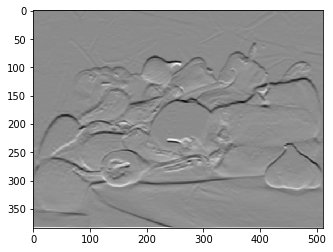

In [706]:
plt.imshow(k,cmap="gray")

In [710]:
k1 = spatial_1(cv_rgb[:,:,0],fx.T)*-1

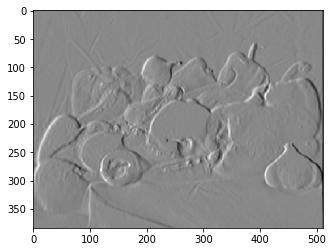

In [711]:
plt.imshow(k1,cmap="gray")

In [712]:
M = np.sqrt(k**2 + k1**2)
M = M/M.max()

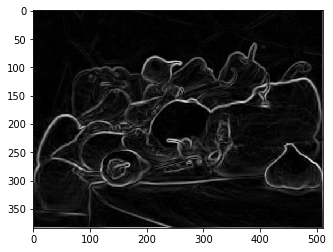

In [713]:
plt.imshow(M,cmap="gray")

# angle 

In [707]:
theta = np.arctan2(fx.T, fx)*(180/np.pi)
# thetaQ = (np.round(theta * (5.0 / np.pi)) + 5) % 5 #Quantize direction
 

In [718]:
v = spatial_1(M,theta)*-1

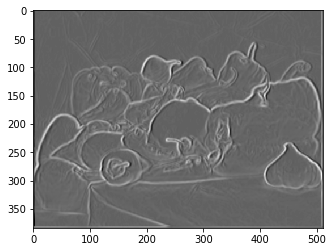

In [719]:
plt.imshow(v,cmap="gray")

# 2

In [28]:
q = np.arange(0,64)

In [29]:
q = q.reshape((8,8))

In [30]:
q

array([[ 0,  1,  2,  3,  4,  5,  6,  7],
       [ 8,  9, 10, 11, 12, 13, 14, 15],
       [16, 17, 18, 19, 20, 21, 22, 23],
       [24, 25, 26, 27, 28, 29, 30, 31],
       [32, 33, 34, 35, 36, 37, 38, 39],
       [40, 41, 42, 43, 44, 45, 46, 47],
       [48, 49, 50, 51, 52, 53, 54, 55],
       [56, 57, 58, 59, 60, 61, 62, 63]])

In [50]:
import scipy.signal

In [34]:
scipy.signal.convolve2d(f,d,mode="same")

array([[ 0.03382395,  0.04921356,  0.05576627,  0.04921356,  0.03382395],
       [ 0.01508072,  0.02194232,  0.0248639 ,  0.02194232,  0.01508072],
       [ 0.        ,  0.        ,  0.        ,  0.        ,  0.        ],
       [-0.01508072, -0.02194232, -0.0248639 , -0.02194232, -0.01508072],
       [-0.03382395, -0.04921356, -0.05576627, -0.04921356, -0.03382395]])

In [37]:
d

array([[ 1],
       [ 0],
       [-1]])

In [38]:
def spatial_1(img,filter_):
    HH,WW = filter_.shape
    H,W = img.shape
    Ph = np.int(np.floor(HH/2.))
    Pw = np.int(np.floor(WW/2.))
    pad_x = np.pad(img, ((Ph,), (Pw,)), 'constant')
    h = int(1 + (H + 2 * Ph - HH) / 1)
    wi = int(1 + (W + 2 * Pw - WW) / 1)

    out = np.zeros((h, wi))

    # for n in range(N):
    for g in range(h):
        for t in range(wi):
            out[g, t] = np.sum(pad_x[g:g + HH, t:t + WW] * filter_)
            
    return out


In [39]:
k = spatial_1(f,d)

In [40]:
k*-1

array([[ 0.03382395,  0.04921356,  0.05576627,  0.04921356,  0.03382395],
       [ 0.01508072,  0.02194232,  0.0248639 ,  0.02194232,  0.01508072],
       [-0.        , -0.        , -0.        , -0.        , -0.        ],
       [-0.01508072, -0.02194232, -0.0248639 , -0.02194232, -0.01508072],
       [-0.03382395, -0.04921356, -0.05576627, -0.04921356, -0.03382395]])

In [41]:
k

array([[-0.03382395, -0.04921356, -0.05576627, -0.04921356, -0.03382395],
       [-0.01508072, -0.02194232, -0.0248639 , -0.02194232, -0.01508072],
       [ 0.        ,  0.        ,  0.        ,  0.        ,  0.        ],
       [ 0.01508072,  0.02194232,  0.0248639 ,  0.02194232,  0.01508072],
       [ 0.03382395,  0.04921356,  0.05576627,  0.04921356,  0.03382395]])

# 2

In [873]:
qange(0,64)

In [874]:
q = q.reshape((8,8))

In [875]:
q

array([[ 0,  1,  2,  3,  4,  5,  6,  7],
       [ 8,  9, 10, 11, 12, 13, 14, 15],
       [16, 17, 18, 19, 20, 21, 22, 23],
       [24, 25, 26, 27, 28, 29, 30, 31],
       [32, 33, 34, 35, 36, 37, 38, 39],
       [40, 41, 42, 43, 44, 45, 46, 47],
       [48, 49, 50, 51, 52, 53, 54, 55],
       [56, 57, 58, 59, 60, 61, 62, 63]])

In [45]:
f = np.ones((3,3))

In [14]:
def nms(img,m):
    HH,WW = 3,3
    H,W = img.shape
    Ph = np.int(np.floor(HH/2.))
    Pw = np.int(np.floor(WW/2.))
    pad_x = np.pad(img, ((Ph,), (Pw,)), 'constant')
    h = int(1 + (H + 2 * Ph - HH) / 1)
    wi = int(1 + (W + 2 * Pw - WW) / 1)

    out = np.zeros((h, wi))
    for i in range(h):
        for j in range(wi):
            if pad_x[i:i+HH,j:j+WW].max() < img[i,j]*m:
                out[i,j] = img[i,j]
            else:
                out[i,j] = 0
    return out

In [47]:
nms(q,2)

array([[ 0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
       [ 0.,  0., 10., 11., 12., 13., 14., 15.],
       [16., 17., 18., 19., 20., 21., 22., 23.],
       [24., 25., 26., 27., 28., 29., 30., 31.],
       [32., 33., 34., 35., 36., 37., 38., 39.],
       [40., 41., 42., 43., 44., 45., 46., 47.],
       [48., 49., 50., 51., 52., 53., 54., 55.],
       [56., 57., 58., 59., 60., 61., 62., 63.]])

In [48]:
q

array([[ 0,  1,  2,  3,  4,  5,  6,  7],
       [ 8,  9, 10, 11, 12, 13, 14, 15],
       [16, 17, 18, 19, 20, 21, 22, 23],
       [24, 25, 26, 27, 28, 29, 30, 31],
       [32, 33, 34, 35, 36, 37, 38, 39],
       [40, 41, 42, 43, 44, 45, 46, 47],
       [48, 49, 50, 51, 52, 53, 54, 55],
       [56, 57, 58, 59, 60, 61, 62, 63]])

In [49]:
q = 0

In [50]:
q

0

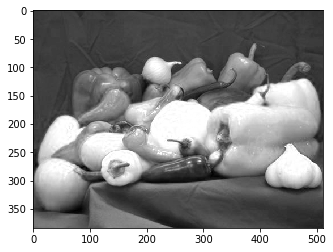

In [51]:
plt.imshow(cv_rgb[:,:,0],cmap="gray")

In [725]:
F = gkern(11,1.5)

In [726]:
Gx = spatial_1(F,d)*-1

In [727]:
Gx

array([[ 7.81441153e-06,  5.77411252e-05,  2.73561160e-04,
         8.31005429e-04,  1.61857756e-03,  2.02135876e-03,
         1.61857756e-03,  8.31005429e-04,  2.73561160e-04,
         5.77411252e-05,  7.81441153e-06],
       [ 3.59649115e-05,  2.65746749e-04,  1.25903312e-03,
         3.82460491e-03,  7.44931317e-03,  9.30306633e-03,
         7.44931317e-03,  3.82460491e-03,  1.25903312e-03,
         2.65746749e-04,  3.59649115e-05],
       [ 1.04649944e-04,  7.73264304e-04,  3.66350810e-03,
         1.11287550e-02,  2.16758549e-02,  2.70698669e-02,
         2.16758549e-02,  1.11287550e-02,  3.66350810e-03,
         7.73264304e-04,  1.04649944e-04],
       [ 1.82028176e-04,  1.34501640e-03,  6.37230823e-03,
         1.93573632e-02,  3.77029953e-02,  4.70853430e-02,
         3.77029953e-02,  1.93573632e-02,  6.37230823e-03,
         1.34501640e-03,  1.82028176e-04],
       [ 1.61096805e-04,  1.19035333e-03,  5.63955823e-03,
         1.71314652e-02,  3.33675380e-02,  4.16710121e-02,
  

In [728]:
Gx.shape

(11, 11)

In [729]:
Gy = Gx.T


In [730]:
Mx  = spatial_1(cv_rgb[:,:,0],Gx)
My  = spatial_1(cv_rgb[:,:,0],Gy)

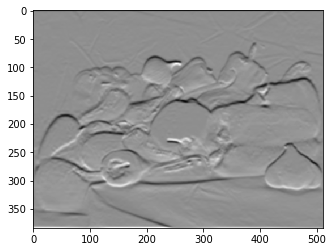

In [731]:
plt.imshow(Mx,cmap="gray")

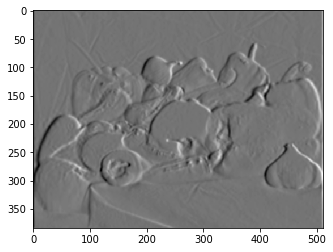

In [732]:
plt.imshow(My,cmap="gray")

In [733]:
M = np.sqrt(Mx**2 + My**2)
M = M/M.max()

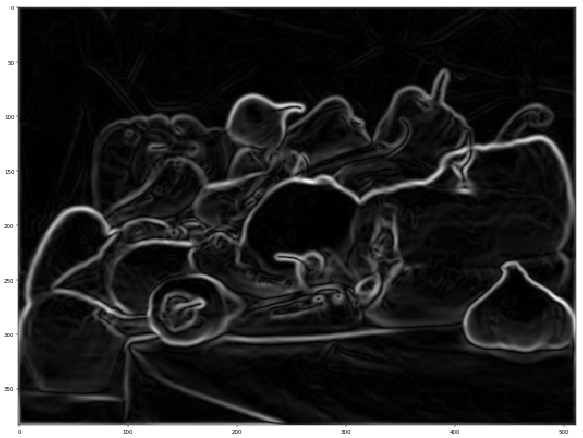

In [61]:
plt.figure(figsize=(18,19),dpi=40)
plt.imshow(M,cmap="gray")

In [734]:
Mn = nms(M,1.1)

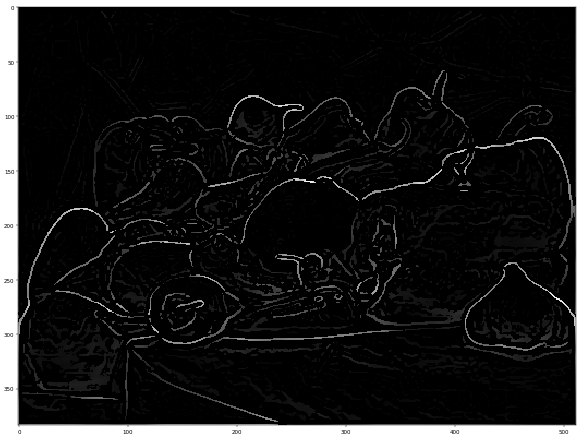

In [735]:
plt.figure(figsize=(18,19),dpi=40)
plt.imshow(Mn,cmap="gray")

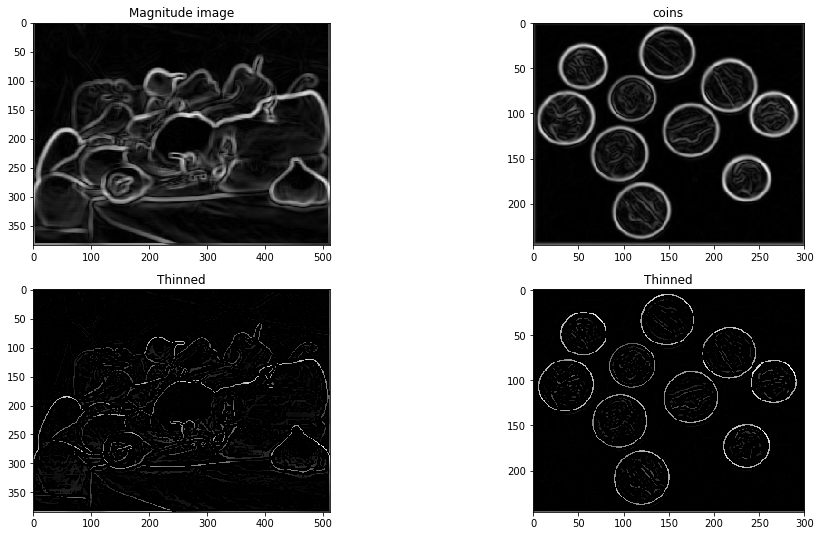

In [752]:
figure = plt.figure(figsize=(16,9))
plt.subplot(2,2,1)

plt.imshow(mag,cmap='gray')
plt.title('Magnitude image')

plt.subplot(2,2,4)
plt.imshow(coins_nms,cmap="gray")
plt.title('Thinned')

plt.subplot(2,2,2)
plt.imshow(coins,cmap="gray")
plt.title('coins')

plt.subplot(2,2,3)
plt.imshow(Mn,cmap="gray")
plt.title('Thinned')
plt.show()

In [736]:
img = cv2.imread('/home/n/images/coins.jpg')
cv_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

In [741]:
coins,_ = get_grad(cv_rgb,11,1.5)

In [742]:
coins_nms = nms(coins,1.1)

# 3

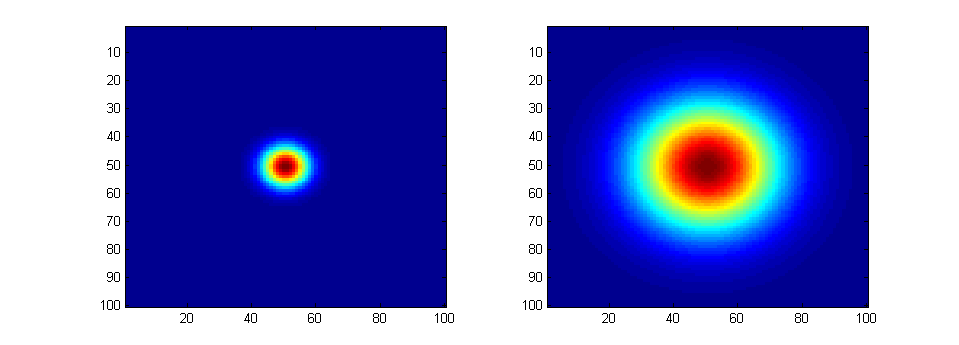

In [64]:
# To find kernel size we use radius,
    
from IPython.display import Image, display
Image('/home/n/Downloads/CQiM7.png')

***
Above the circle indicates the range of blur in gaussian. We find the radius of the circle using sigma.
General approximation that r=2*$\sigma $

Kernel size = (2*r+1)x(2*r+1)
***

In [52]:
def apply_hysteresis_threshold(image, low, high):
#     import pdb
###source github
#     low = np.clip(low, a_min=None, a_max=high)  # ensure low always below high
    mask_low = image > low #keeps value greater than low threshold
    mask_high = image > high # keeps values greater than threshold
    # Connected components of mask_low
    labels_low, num_labels = ndi.label(mask_low) #we find unique labels for different features
#     pdb.set_trace()
    # Check which connected components contain pixels from mask_high
    sums = ndi.sum(mask_high, labels_low, np.arange(num_labels + 1)) # This add the mask_high
    #features who have same label
    
    connected_to_high = sums > 0 # To create a mask fo boolean logic, so to fit on labels_low
    thresholded = connected_to_high[labels_low]
    return thresholded


In [53]:
import skimage
from scipy import ndimage as ndi

In [72]:
Mn.max()

1.0

In [755]:
Nn = apply_hysteresis_threshold(Mn,0.1,0.20)

In [756]:
Nn.shape

(384, 512)

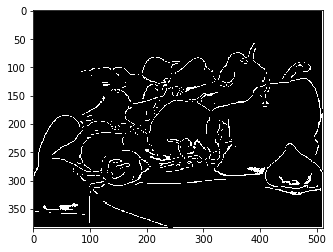

In [757]:
plt.imshow(Nn,cmap="gray")

In [54]:
def getEdges(I,sigma,low,high):
    r = 2*sigma
    k = int(np.floor(2*r+1))
    m,n = get_grad(I,k,sigma)
    i = nms(m,1.1)
    t = apply_hysteresis_threshold(i, low, high)
    return t
    

In [761]:
T = getEdges(cv_rgb,2,0.1,0.20)

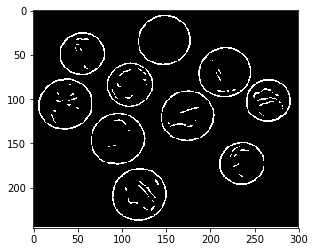

In [762]:
plt.imshow(T,cmap="gray")

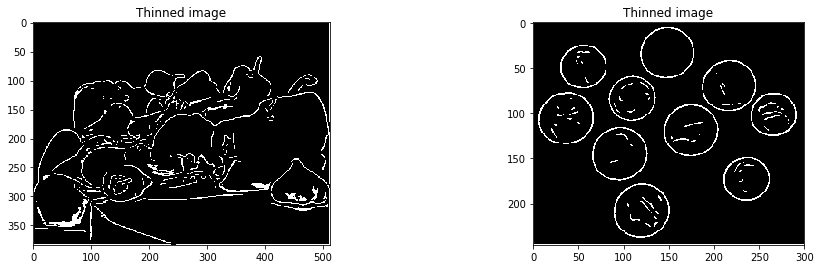

In [764]:
figure = plt.figure(figsize=(16,9))
plt.subplot(2,2,1)
mag = getEdges(cv_rgb,7,0.1,0.20)
plt.imshow(mag,cmap='gray')
plt.title('Thinned image')

plt.subplot(2,2,2)
mag = getEdges(cv_rgbc,7,0.1,0.20)
plt.imshow(mag,cmap='gray')
plt.title('Thinned image')

plt.show()

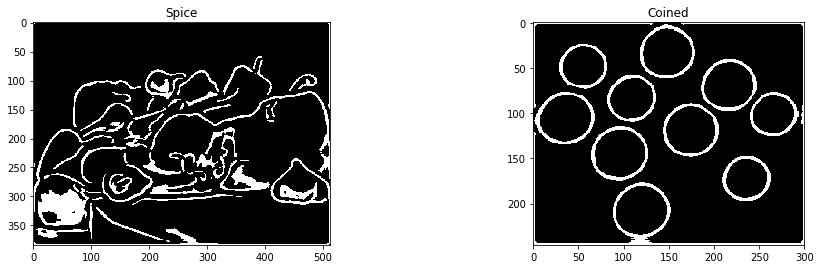

In [59]:
figure = plt.figure(figsize=(16,9))
plt.subplot(2,2,1)
mag = getEdges(cv_rgb,4,0.1,0.30)
plt.imshow(mag,cmap='gray')
plt.title('Spice')

plt.subplot(2,2,2)
mag = getEdges(cv_rgbc,4,0.1,0.30)
plt.imshow(mag,cmap='gray')
plt.title('Coined')

plt.show()

# RANSAC

In [1]:
import pandas as pd

In [6]:
import pandas as pd
df = pd.read_csv('/home/n/Downloads/lineData.txt', delim_whitespace=True, engine = 'python', names = range(2))

In [3]:
g = pd.DataFrame(df)

In [4]:
 df.loc[0] = [0]

In [8]:
df

,0,1
0,1.00,2.154972
1,1.25,634.152000
2,1.50,579.031360
3,1.75,6.459895
4,2.00,5.421817
5,2.25,3.380308
6,2.50,9.806418
7,2.75,4.398591
8,3.00,6.849285
9,3.25,9.484560


In [266]:
g.columns = ["lol"]

In [267]:
g.loc[0] = ["1.0000000e+00 2.1549717e+00"]

In [268]:
g

,lol
0,1.0000000e+00 2.1549717e+00
1,1.5000000e+00 5.7903136e+02
2,1.7500000e+00 6.4598948e+00
3,2.0000000e+00 5.4218170e+00
4,2.2500000e+00 3.3803080e+00
5,2.5000000e+00 9.8064181e+00
6,2.7500000e+00 4.3985910e+00
7,3.0000000e+00 6.8492849e+00
8,3.2500000e+00 9.4845597e+00
9,3.5000000e+00 1.0120010e+01


In [264]:
index = np.arange(0,65)

In [243]:
df = g.sort_index()

TypeError: '<' not supported between instances of 'int' and 'str'

In [148]:
df.columns[0].append([1])

AttributeError: 'str' object has no attribute 'append'

In [253]:
g = g.reset_index(col_level=7)

ValueError: cannot insert level_0, already exists

In [255]:
g

,level_0,index,lol
0,0,1,1.5000000e+00 5.7903136e+02
1,1,2,1.7500000e+00 6.4598948e+00
2,2,3,2.0000000e+00 5.4218170e+00
3,3,4,2.2500000e+00 3.3803080e+00
4,4,5,2.5000000e+00 9.8064181e+00
5,5,6,2.7500000e+00 4.3985910e+00
6,6,7,3.0000000e+00 6.8492849e+00
7,7,8,3.2500000e+00 9.4845597e+00
8,8,9,3.5000000e+00 1.0120010e+01
9,9,10,3.7500000e+00 5.4822420e+00


In [114]:
j

MultiIndex(levels=[[''], ['  1.0000000e+00   2.1549717e+00']],
           labels=[[0], [0]])

In [770]:
df

,0,1
0,1.00,2.154972
1,1.25,634.152000
2,1.50,579.031360
3,1.75,6.459895
4,2.00,5.421817
5,2.25,3.380308
6,2.50,9.806418
7,2.75,4.398591
8,3.00,6.849285
9,3.25,9.484560


In [278]:
df[0][1]

1.25

In [771]:
df.columns = ["x","y"]

In [293]:
df

,x,y
0,1.00,2.154972
1,1.25,634.152000
2,1.50,579.031360
3,1.75,6.459895
4,2.00,5.421817
5,2.25,3.380308
6,2.50,9.806418
7,2.75,4.398591
8,3.00,6.849285
9,3.25,9.484560


In [774]:
df['o'] = a

In [773]:
a = pd.Series(np.ones((66)))

In [775]:
a.shape

(66,)

In [776]:
import numpy as np

In [306]:
df = df[['x','o','y']]

In [309]:
df

,x,o,y
0,1.00,1.0,2.154972
1,1.25,1.0,634.152000
2,1.50,1.0,579.031360
3,1.75,1.0,6.459895
4,2.00,1.0,5.421817
5,2.25,1.0,3.380308
6,2.50,1.0,9.806418
7,2.75,1.0,4.398591
8,3.00,1.0,6.849285
9,3.25,1.0,9.484560


In [779]:
X = df['x']
B = df['o']
Y = df['y']

In [320]:
xTx = X.dot(X) 

In [321]:
xTx

2024.0

In [322]:
XT = X.T

In [780]:
X = np.array(X)

In [353]:
M =df[['x','o']]

In [355]:
M = M.as_matrix()

In [357]:
M.shape

(66, 2)

In [326]:
xTx

2024.0

In [781]:
X = X.reshape(66,1)

In [358]:
XX = M.T

array([[1.  , 1.25, 1.5 , 1.75, 2.  , 2.25, 2.5 , 2.75, 3.  , 3.25, 3.5 ,
        3.75, 4.  , 4.25, 4.5 , 4.75, 5.  , 5.25, 5.5 , 5.75, 6.  , 6.25,
        6.5 , 6.75, 7.  , 7.25, 7.5 , 7.75, 8.  , 8.25, 8.5 , 8.75, 9.  ,
        1.  , 1.25, 1.5 , 1.75, 2.  , 2.25, 2.5 , 2.75, 3.  , 3.25, 3.5 ,
        3.75, 4.  , 4.25, 4.5 , 4.75, 5.  , 5.25, 5.5 , 5.75, 6.  , 6.25,
        6.5 , 6.75, 7.  , 7.25, 7.5 , 7.75, 8.  , 8.25, 8.5 , 8.75, 9.  ]])

In [365]:
xTx = XX.dot(M)

In [366]:
xinv = np.linalg.pinv(xTx)

In [367]:
xinv.shape

(2, 2)

In [782]:
y = np.array(Y).reshape((66,1))

In [783]:
y.shape

(66, 1)

In [370]:
B = XX.dot(y)

In [371]:
c = xinv.dot(B)

In [372]:
c.shape

(2, 1)

In [379]:
s = M.dot(c)

In [380]:
s.shape

(66, 1)

In [382]:
M = df[['x','o']]

In [383]:
M = M.as_matrix()

In [385]:
# M ->  66x2
# M.T -> 2x66
# M.T X M -> 66x66
# (M.T x M)^{-1} x M x Y

In [386]:
minv = np.linalg.pinv(M.T.dot(M))

In [389]:
minvm = minv.dot(M.T)

In [392]:
vall = minvm.dot(y)

In [393]:
M.dot(vall)

array([[ 70.35772005],
       [ 67.78411155],
       [ 65.21050306],
       [ 62.63689456],
       [ 60.06328607],
       [ 57.48967757],
       [ 54.91606907],
       [ 52.34246058],
       [ 49.76885208],
       [ 47.19524359],
       [ 44.62163509],
       [ 42.0480266 ],
       [ 39.4744181 ],
       [ 36.90080961],
       [ 34.32720111],
       [ 31.75359261],
       [ 29.17998412],
       [ 26.60637562],
       [ 24.03276713],
       [ 21.45915863],
       [ 18.88555014],
       [ 16.31194164],
       [ 13.73833314],
       [ 11.16472465],
       [  8.59111615],
       [  6.01750766],
       [  3.44389916],
       [  0.87029067],
       [ -1.70331783],
       [ -4.27692633],
       [ -6.85053482],
       [ -9.42414332],
       [-11.99775181],
       [ 70.35772005],
       [ 67.78411155],
       [ 65.21050306],
       [ 62.63689456],
       [ 60.06328607],
       [ 57.48967757],
       [ 54.91606907],
       [ 52.34246058],
       [ 49.76885208],
       [ 47.19524359],
       [ 44

In [394]:
Y

0       2.154972
1     634.152000
2     579.031360
3       6.459895
4       5.421817
5       3.380308
6       9.806418
7       4.398591
8       6.849285
9       9.484560
10     10.120010
11      5.482242
12      7.656399
13      6.952029
14      8.721229
15      9.189975
16      7.454469
17     11.258000
18     11.840412
19     11.110776
20     11.108229
21     11.823565
22      8.567007
23     11.152910
24     12.178466
25     14.803120
26     15.446130
27     14.660891
28     17.168091
29     17.004677
         ...    
36      2.255993
37      4.918548
38      4.199903
39      5.869189
40      3.828078
41      7.596540
42      1.685545
43      5.615149
44     11.828535
45     11.310893
46      8.637920
47      6.981953
48      8.333849
49      8.632357
50     11.621834
51     14.290315
52     11.228974
53     11.894115
54     12.181949
55     15.498348
56     12.940793
57     14.631132
58     12.493680
59     16.472135
60     13.010666
61     16.914113
62     14.625476
63     23.2433

In [395]:
import matplotlib.pyplot as plt

In [906]:
def model(path,iteration,samples_):
    model = []
    for x in range(iteration):
        df = pd.read_csv(path, delim_whitespace=True, engine = 'python', names = range(2))
        df.columns = ['x','y']
        df['b'] = np.ones((df.shape[0],1))
        df = df[['x','b','y']]
        x = df['x'].as_matrix()
        y = df['y'].as_matrix()
        M = df[['x','b']].as_matrix()

        reshuffled_ind = np.random.randint(0,df.shape[0],samples_)
        M = M[reshuffled_ind]
        y = y[reshuffled_ind].reshape((len(reshuffled_ind),1))

        mt = M.T.dot(M)
        mti = np.linalg.pinv(mt)
        mtim = mti.dot(M.T)
        mtimy = mtim.dot(y)
        model.append(mtimy)
        
    return model
    

In [907]:
vall = np.array(vall)

In [912]:
vall

[array([[-23.26724666],
        [168.09293985]])]

In [911]:
vall = model('/home/n/Downloads/lineData.txt',1,65)

Text(0,0.5,'Y')

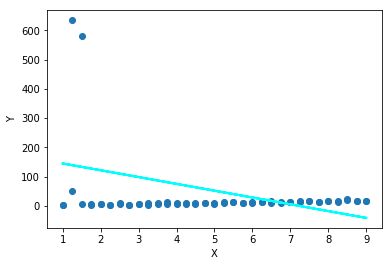

In [913]:
# plt.figure(figsize=(18,19),dpi=40)

plt.scatter(X,Y)
plt.plot(X,vall[0][0]*X+vall[0][1],linewidth=2.0,color="cyan",label="Least Square")
plt.xlabel('X')
plt.ylabel('Y')

In [403]:
X.shape

(66, 1)

In [405]:
Y = Y.reshape((66,1))

/home/n/anaconda3/envs/opencv/lib/python3.6/site-packages/ipykernel_launcher.py:1: FutureWarning: reshape is deprecated and will raise in a subsequent release. Please use .values.reshape(...) instead
  """Entry point for launching an IPython kernel.


In [816]:
f,g = vall[0]

# 2.2

***
Ransac
1. Select N number of points randomly from the given set
2. Plot the points from the step 1
3. Calculate the number of inliers after fitting the line.
4. repeat the step, and select the model which has highest number of inliers


***


***
Define a function that ccepts model, and ponits from which distance needed to be calculated

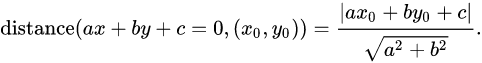
***

***
We iterate for the points fromt he data given, to find number of inliers
This will be used as voting for perfect line
***

***
Defining RANSAC

step 1 we shuffle the number of indices we have from the data.

step 2 we fit the model using pseudo inverse method


***

In [899]:
import pandas as pd
df = pd.read_csv('/home/n/Downloads/lineData.txt', delim_whitespace=True, engine = 'python', names = range(2))


In [900]:
df.columns = ['x','y']

In [418]:
df['b'] = np.ones((66,1))

df = df[['x','b','y']]

In [910]:
def line_dist(model,x,y):
    a,c = model
    d = np.abs(a*x + y + c)/np.sqrt(a**2 + 1)
    return d


    

In [444]:
line_fit(np.array([[80],[-10]]),2,2)

array([1.89985158])

In [901]:
x = df['x'].as_matrix()
y = df['y'].as_matrix()
M = df[['x']].as_matrix()

In [459]:
reshuffled_ind = np.random.randint(0,65,20)

In [460]:
reshuffled_ind

array([41, 20, 29, 39, 14, 34, 19, 14, 59, 60, 50, 31, 56, 63, 51, 57, 27,
       50, 41,  9])

In [469]:
y[reshuffled_ind].reshape((len(reshuffled_ind),1))

array([[ 7.5965399],
       [11.108229 ],
       [17.004677 ],
       [ 5.869189 ],
       [ 8.7212287],
       [51.225471 ],
       [11.110776 ],
       [ 8.7212287],
       [16.472135 ],
       [13.010666 ],
       [11.621834 ],
       [17.42078  ],
       [12.940793 ],
       [23.243354 ],
       [14.290315 ],
       [14.631132 ],
       [14.660891 ],
       [11.621834 ],
       [ 7.5965399],
       [ 9.4845597]])

In [471]:
M[reshuffled_ind].shape

(20, 2)

In [472]:
mt = M.T.dot(M)

In [473]:
mti = np.linalg.pinv(mt)

In [474]:
mtim = mti.dot(M.T)

In [475]:
mtimy = mtim.dot(y)

In [481]:
d,f = mtimy

In [909]:
def model(path,iteration,samples_):
    model = []
    for x in range(iteration):
        df = pd.read_csv(path, delim_whitespace=True, engine = 'python', names = range(2))
        df.columns = ['x','y']
        df['b'] = np.ones((df.shape[0],1))
        df = df[['x','b','y']]
        x = df['x'].as_matrix()
        y = df['y'].as_matrix()
        M = df[['x','b']].as_matrix()

        reshuffled_ind = np.random.randint(0,df.shape[0],samples_)
        M = M[reshuffled_ind]
        y = y[reshuffled_ind].reshape((len(reshuffled_ind),1))

        mt = M.T.dot(M)
        mti = np.linalg.pinv(mt)
        mtim = mti.dot(M.T)
        mtimy = mtim.dot(y)
        model.append(mtimy)
        
    return model
    

In [874]:
def model(path,iteration,samples_):
    model = []
    for x in range(iteration):
        df = pd.read_csv(path, delim_whitespace=True, engine = 'python', names = range(2))
        df.columns = ['x','y']
#         df['b'] = np.ones((df.shape[0],1))
#         df = df[['x','b','y']]
        x = df['x'].as_matrix()
        y = df['y'].as_matrix()
        M = df[['x']].as_matrix()

        reshuffled_ind = np.random.randint(0,df.shape[0],samples_)
        M = M[reshuffled_ind]
        y = y[reshuffled_ind].reshape((len(reshuffled_ind),1))

        mt = M.T.dot(M)
        mti = np.linalg.pinv(mt)
        mtim = mti.dot(M.T)
        mtimy = mtim.dot(y)
        model.append(mtimy)
        
    return model
    

In [875]:
vall = model('/home/n/Downloads/lineData.txt',1,65)

In [876]:
vall

[array([[2.84972719]])]

In [877]:
def find_inliers(model,x,y,threshold,ratio):
    dic = {}
    num = 0
    for i,mod in enumerate(model):
        print(mod)
        i = 0
        mod = np.array(mod)
        for x1,y1 in zip(x,y):
            d = line_dist(mod,x1,y1)
        #     i = 0
            if d < threshold:
                i = i+1
        print("no of inliers:{} model:{}".format(i,mod))
        if i*ratio > num:
            num = i*ratio
            best_ = mod
        dic[i] = i*ratio
    return dic,best_
    

In [878]:
model_ =  model('/home/n/Downloads/lineData.txt',50,65)

In [879]:
h,best = find_inliers(model_,X,Y,2,0.9)

[[2.97335822]]
no of inliers:2 model:[[2.97335822]]
[[3.93928309]]
no of inliers:2 model:[[3.93928309]]
[[3.34744314]]
no of inliers:2 model:[[3.34744314]]
[[2.98957793]]
no of inliers:2 model:[[2.98957793]]
[[2.99562221]]
no of inliers:2 model:[[2.99562221]]
[[2.42954731]]
no of inliers:1 model:[[2.42954731]]
[[3.36067481]]
no of inliers:2 model:[[3.36067481]]
[[4.02815112]]
no of inliers:2 model:[[4.02815112]]
[[2.4951082]]
no of inliers:1 model:[[2.4951082]]
[[2.30861844]]
no of inliers:1 model:[[2.30861844]]
[[2.97262488]]
no of inliers:2 model:[[2.97262488]]
[[2.41470257]]
no of inliers:1 model:[[2.41470257]]
[[2.82290432]]
no of inliers:1 model:[[2.82290432]]
[[3.45606615]]
no of inliers:2 model:[[3.45606615]]
[[2.43705154]]
no of inliers:1 model:[[2.43705154]]
[[3.42456471]]
no of inliers:2 model:[[3.42456471]]
[[4.09003293]]
no of inliers:2 model:[[4.09003293]]
[[3.24694031]]
no of inliers:2 model:[[3.24694031]]
[[4.07783058]]
no of inliers:2 model:[[4.07783058]]
[[2.46419272]]

In [880]:
best

array([[2.97335822]])

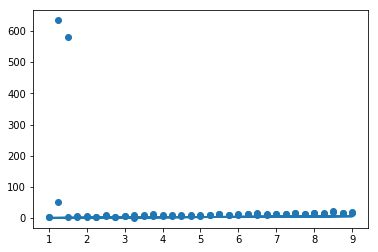

In [856]:


# Learn about API authentication here: https://plot.ly/python/getting-started
# Find your api_key here: https://plot.ly/settings/api
plt.scatter(x,y)
plt.plot(x,0.68561459*x,linewidth=2.0)

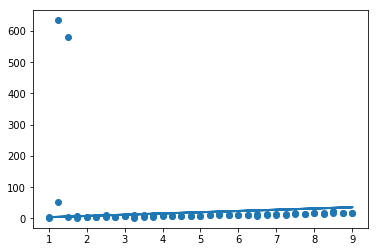

In [860]:
plt.scatter(x,y)
plt.plot(x,3.9786*x,linewidth=2.0)

<function matplotlib.pyplot.legend>

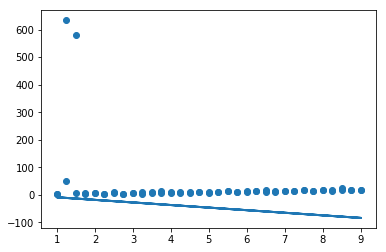

In [885]:
plt.scatter(x,y)
plt.plot(x,-9.3721673 *x,linewidth=2.0)
plt.legend

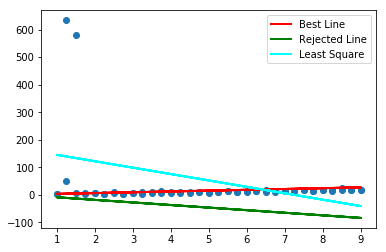

In [914]:
plt.scatter(x,y)
plt.plot(x,2.97 *x,linewidth=2.0,label='Best Line',color="red")
plt.plot(x,-9.3721673 *x,linewidth=2.0,label='Rejected Line',color="green")
plt.plot(X,vall[0][0]*X+vall[0][1],linewidth=2.0,color="cyan",label="Least Square")

plt.legend()

In [813]:
model_ = model('/home/n/Downloads/lineData.txt',30,40)

In [551]:
x,y = model_[29]

# 2.3

In [618]:
h = model('/home/n/Downloads/circleData.txt',20,20)

In [619]:
def modelc(path,iteration,samples_):
    model = []
    for x in range(iteration):
        df = pd.read_csv(path, delim_whitespace=True, engine = 'python', names = range(2))
        df.columns = ['x','y']
        df['b'] = np.ones((df.shape[0],1))
        df = df[['x','b','y']]
        x = df['x'].as_matrix()
        y = df['y'].as_matrix()
        M = df[['x','b']].as_matrix()

        reshuffled_ind = np.random.randint(0,df.shape[0],samples_)
        M = M[reshuffled_ind]
        y = y[reshuffled_ind].reshape((len(reshuffled_ind),1))

        mt = M.T.dot(M)
        mti = np.linalg.pinv(mt)
        mtim = mti.dot(M.T)
        mtimy = mtim.dot(y)
        model.append(mtimy)
        
    return model

[array([[ 0.01781695],
        [-0.04553273]]), array([[0.30716759],
        [0.32299576]]), array([[ 0.06442679],
        [-0.03585851]]), array([[-0.01247384],
        [ 0.09580171]]), array([[-0.01393755],
        [ 0.54143891]]), array([[0.02603384],
        [0.06182188]]), array([[-0.01749239],
        [ 0.15462018]]), array([[0.42912047],
        [0.44363484]]), array([[-0.04263439],
        [ 0.31985769]]), array([[ 0.3083883 ],
        [-0.01136967]]), array([[-0.08570881],
        [-0.05110275]]), array([[ 0.08919949],
        [-0.09837239]]), array([[ 0.03182519],
        [-0.14583823]]), array([[0.00791916],
        [0.01146047]]), array([[ 0.00639955],
        [-0.12209008]]), array([[0.5058201 ],
        [0.26774369]]), array([[-0.06986636],
        [ 0.35075965]]), array([[-0.02365243],
        [-0.31299191]]), array([[ 0.04780932],
        [-0.12501808]]), array([[ 0.06187471],
        [-0.28673529]])]

In [622]:
y

array([  2.1549717, 634.152    , 579.03136  ,   6.4598948,   5.421817 ,
         3.380308 ,   9.8064181,   4.398591 ,   6.8492849,   9.4845597,
        10.12001  ,   5.482242 ,   7.6563995,   6.9520294,   8.7212287,
         9.1899747,   7.4544688,  11.258    ,  11.840412 ,  11.110776 ,
        11.108229 ,  11.823565 ,   8.5670067,  11.15291  ,  12.178466 ,
        14.80312  ,  15.44613  ,  14.660891 ,  17.168091 ,  17.004677 ,
        18.707359 ,  17.42078  ,  18.188903 ,   3.2419011,  51.225471 ,
         5.139797 ,   2.2559928,   4.9185482,   4.1999032,   5.869189 ,
         3.8280782,   7.5965399,   1.685545 ,   5.6151486,  11.828535 ,
        11.310893 ,   8.6379197,   6.9819533,   8.3338493,   8.6323575,
        11.621834 ,  14.290315 ,  11.228974 ,  11.894115 ,  12.181949 ,
        15.498348 ,  12.940793 ,  14.631132 ,  12.49368  ,  16.472135 ,
        13.010666 ,  16.914113 ,  14.625476 ,  23.243354 ,  17.999312 ,
        16.37626  ])

In [624]:
import pandas as pd
df = pd.read_csv('/home/n/Downloads/circleData.txt', delim_whitespace=True, engine = 'python', names = range(2))

In [626]:
df.columns = ['x','y']

TypeError: 'numpy.ndarray' object is not callable

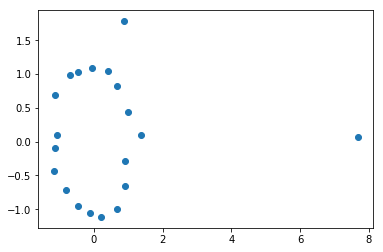

In [636]:
plt.scatter(df['x'],df['y'])
f = np.polyval(x,h)

for x1,y1 in zip(x,y):
    plt.plot(x1, f(x1), 'b+')


In [628]:
h = np.polyfit(df['x'],df['y'],2)

In [629]:
h

array([-0.00972528,  0.07222115,  0.09926819])

In [ ]:
def fitCircle(points):
    x=points[:,0]
    y=points[:,1]
    x1 = x-np.mean(x)
    y1 = y-np.mean(y)
    xx = np.array([[sum(x1**2),sum(x1*y1)],[sum(x1*y1),sum(y1**2)]])
    yy = np.array([(sum(x1**3)+sum(x1*y1**2))/2,(sum(y1**3)+sum(y1*x1**2))/2])
    uc,vc = np.linalg.solve(xx,yy)
    xc = uc+np.mean(x)
    yc = vc+np.mean(y)
    r = np.sqrt((uc**2)+(vc**2)+((sum(x1**2)+sum(y1**2))/2))
    return xc,yc,r
def fitCircleRANSAC(points,iter1,thr,inlierRatio):
    x=points[:,0]
    y=points[:,1]
    x1 = np.array(x,dtype=float)
    y1 = np.array(y,dtype=float)
    n = len(points)
    goal_inliers = int(inlierRatio * n)
    in1 =np.ones(len(x),dtype=bool)
    bln_found = False
    for i in range(iter1):
        ic =0
        c=0
        s = np.random.randint((2*n))
        np.random.seed(s)
        xr = np.random.choice(x1,2,replace=False)#####
        np.random.seed(s)
        yr = np.random.choice(y1,4,replace=False)######
        stack_list = np.vstack(zip(xr,yr))
        xc,yc,rad=fitCircle(stack_list)
        ix =[]
        iy =[]
        for x,y in zip(x1,y1):            #######
            c+=1
            if x not in xr:
                dist = np.sqrt((x-xc)**2+(y-yc)**2)-rad
                if dist<thr:
                    ix.append(x)
                    iy.append(y)
                    ic+=1
                    in1[c]=True
            if(ic>=goal_inliers):
                bln_found = True
                break
        if(bln_found):
            break
    stack_lst = np.vstack(zip(ix,iy))
    xc,yc,rad = fitCircle(stack_lst)
    return xc,yc,rad




dff= np.array(df1, dtype = float)
xc,yc,rad = fitCircle(dff)
xpoints_lst1 = np.array(xpoints_lst,dtype=float)
ypoints_lst1 = np.array(ypoints_lst,dtype=float)
print(xc,yc,rad)
figure = plt.figure(figsize=(25,16))
fig, ax = plt.subplots()
circle = plt.Circle((xc,yc),rad)
ax=plt.gca()
ax.plot(xpoints_lst1,ypoints_lst1,'ro')
ax.add_patch(circle)
plt.axis('scaled')
plt.show()





dff= np.array(df1, dtype = float)
xc,yc,rad = fitCircleRANSAC(dff,10,1,0.9)
xpoints_lst1 = np.array(xpoints_lst,dtype=float)
ypoints_lst1 = np.array(ypoints_lst,dtype=float)
print(xc,yc,rad)
figure = plt.figure(figsize=(25,16))
fig, ax = plt.subplots()
circle = plt.Circle((xc,yc),rad)
ax=plt.gca()
ax.plot(xpoints_lst1,ypoints_lst1,'ro')
ax.add_patch(circle)
plt.axis('scaled')
plt.show()



In [889]:
def get_circle_(path):
    df = pd.read_csv(path, delim_whitespace=True, engine = 'python', names = range(2))
    df.columns = ['x','y']
#         df['b'] = np.ones((df.shape[0],1))
    df = df[['x','y']]
    x = df['x'].as_matrix()
    y = df['y'].as_matrix()
#         M = df[['x','b']].as_matrix()
    
    x1 = x-np.mean(x)
    
    y1 = y-np.mean(y)
    xx = np.array([[sum(x1**2),sum(x1*y1)],[sum(x1*y1),sum(y1**2)]])
    yy = np.array([(sum(x1**3)+sum(x1*y1**2))/2,(sum(y1**3)+sum(y1*x1**2))/2])
    
    lol1,lol2 = np.linalg.solve(xx,yy)
    x = lol1+np.mean(x)
    y = lol2+np.mean(y)
    r = np.sqrt((lol1**2)+(lol2**2)+((sum(x1**2)+sum(y1**2))/2))
    
    return x,y,r

In [ ]:
def Circle_Ransac(paths,iteration,threshold,ratio):
    df = pd.read_csv(path, delim_whitespace=True, engine = 'python', names = range(2))
    df.columns = ['x','y']
#         df['b'] = np.ones((df.shape[0],1))
    df = df[['x','y']]
    x = df['x'].as_matrix()
    y = df['y'].as_matrix()
    
    n = len(x)
    
    inliers_thres = int(ratio * n)
    in1 =np.ones(len(x),dtype=bool)
    bln_found = False
    for i in range(iter1):
        ic =0
        c=0
        s = np.random.randint((2*n))
        np.random.seed(s)
        xr = np.random.choice(x1,2,replace=False)#####
        np.random.seed(s)
        yr = np.random.choice(y1,4,replace=False)######
        stack_list = np.vstack(zip(xr,yr))
        xc,yc,rad=fitCircle(stack_list)
        ix =[]
        iy =[]
        for x,y in zip(x1,y1):            #######
            c+=1
            if x not in xr:
                dist = np.sqrt((x-xc)**2+(y-yc)**2)-rad
                if dist<thr:
                    ix.append(x)
                    iy.append(y)
                    ic+=1
                    in1[c]=True
            if(ic>=goal_inliers):
                bln_found = True
                break
        if(bln_found):
            break
    stack_lst = np.vstack(zip(ix,iy))
    xc,yc,rad = fitCircle(stack_lst)
    return xc,yc,rad


In [890]:

class CircleModel(BaseModel):

    def estimate(self, data):
       

        _check_data_dim(data, dim=2)

        x = data[:, 0]
        y = data[:, 1]

        # http://www.had2know.com/academics/best-fit-circle-least-squares.html
        x2y2 = (x ** 2 + y ** 2)
        sum_x = np.sum(x)
        sum_y = np.sum(y)
        sum_xy = np.sum(x * y)
        m1 = np.array([[np.sum(x ** 2), sum_xy, sum_x],
                       [sum_xy, np.sum(y ** 2), sum_y],
                       [sum_x, sum_y, float(len(x))]])
        m2 = np.array([[np.sum(x * x2y2),
                        np.sum(y * x2y2),
                        np.sum(x2y2)]]).T
        a, b, c = np.linalg.pinv(m1).dot(m2)
        a, b, c = a[0], b[0], c[0]
        xc = a / 2
        yc = b / 2
        r = np.sqrt(4 * c + a ** 2 + b ** 2) / 2

        self.params = (xc, yc, r)

        return True

    def residuals(self, data):
        

        _check_data_dim(data, dim=2)

        xc, yc, r = self.params

        x = data[:, 0]
        y = data[:, 1]

        return r - np.sqrt((x - xc)**2 + (y - yc)**2)

    def predict_xy(self, t, params=None):
       
        if params is None:
            params = self.params
        xc, yc, r = params

        x = xc + r * np.cos(t)
        y = yc + r * np.sin(t)

        return np.concatenate((x[..., None], y[..., None]), axis=t.ndim)


NameError: name 'BaseModel' is not defined

In [891]:
def ransac(data, model_class, min_samples, residual_threshold,
           is_data_valid=None, is_model_valid=None,
           max_trials=100, stop_sample_num=np.inf, stop_residuals_sum=0,
           stop_probability=1, random_state=None):
    best_model = None
    best_inlier_num = 0
    best_inlier_residuals_sum = np.inf
    best_inliers = None

    random_state = check_random_state(random_state)

    if min_samples < 0:
        raise ValueError("`min_samples` must be greater than zero")

    if max_trials < 0:
        raise ValueError("`max_trials` must be greater than zero")

    if stop_probability < 0 or stop_probability > 1:
        raise ValueError("`stop_probability` must be in range [0, 1]")

    if not isinstance(data, list) and not isinstance(data, tuple):
        data = [data]

    # make sure data is list and not tuple, so it can be modified below
    data = list(data)
    # number of samples
    num_samples = data[0].shape[0]

    for num_trials in range(max_trials):

        # choose random sample set
        samples = []
        random_idxs = random_state.randint(0, num_samples, min_samples)
        for d in data:
            samples.append(d[random_idxs])

        # check if random sample set is valid
        if is_data_valid is not None and not is_data_valid(*samples):
            continue

        # estimate model for current random sample set
        sample_model = model_class()

        success = sample_model.estimate(*samples)

        if success is not None:  # backwards compatibility
            if not success:
                continue

        # check if estimated model is valid
        if is_model_valid is not None \
                and not is_model_valid(sample_model, *samples):
            continue

        sample_model_residuals = np.abs(sample_model.residuals(*data))
        # consensus set / inliers
        sample_model_inliers = sample_model_residuals < residual_threshold
        sample_model_residuals_sum = np.sum(sample_model_residuals**2)

        # choose as new best model if number of inliers is maximal
        sample_inlier_num = np.sum(sample_model_inliers)
        if (
            # more inliers
            sample_inlier_num > best_inlier_num
            # same number of inliers but less "error" in terms of residuals
            or (sample_inlier_num == best_inlier_num
                and sample_model_residuals_sum < best_inlier_residuals_sum)
        ):
            best_model = sample_model
            best_inlier_num = sample_inlier_num
            best_inlier_residuals_sum = sample_model_residuals_sum
            best_inliers = sample_model_inliers
            if (
                best_inlier_num >= stop_sample_num
                or best_inlier_residuals_sum <= stop_residuals_sum
                or num_trials
                    >= _dynamic_max_trials(best_inlier_num, num_samples,
                                           min_samples, stop_probability)
            ):
                break

    # estimate final model using all inliers
    if best_inliers is not None:
        # select inliers for each data array
        for i in range(len(data)):
            data[i] = data[i][best_inliers]
        best_model.estimate(*data)

    return best_model, best_inliers

In [895]:
from skimage.measure import CircleModel

# points = np.array(np.nonzero(edges)).T

model_robust, inliers = ransac(df, CircleModel, min_samples=3,
                               residual_threshold=2, max_trials=1000)

NameError: name 'check_random_state' is not defined

In [893]:
df = df.as_matrix()

In [652]:
def ransac_polyfit(x, y, order=3, n=20, k=100, t=0.1, d=100, f=0.8):
  # Thanks https://en.wikipedia.org/wiki/Random_sample_consensus
  
  # n – minimum number of data points required to fit the model
  # k – maximum number of iterations allowed in the algorithm
  # t – threshold value to determine when a data point fits a model
  # d – number of close data points required to assert that a model fits well to data
  # f – fraction of close data points required
  
    besterr = np.inf
    bestfit = None
    for kk in range(k):
        maybeinliers = np.random.randint(len(x), size=n)
        maybemodel = np.polyfit(x[maybeinliers], y[maybeinliers], order)
        alsoinliers = np.abs(np.polyval(maybemodel, x)-y) < t
        if sum(alsoinliers) > d and sum(alsoinliers) > len(x)*f:
            bettermodel = np.polyfit(x[alsoinliers], y[alsoinliers], order)
            thiserr = np.sum(np.abs(np.polyval(bettermodel, x[alsoinliers])-y[alsoinliers]))
            if thiserr < besterr:
                bestfit = bettermodel
                besterr = thiserr
                print(bestfit)
    return bestfit

In [653]:
v = ransac_polyfit(x,y,2,20,20,0.1,6,0.9)

In [654]:
v

In [655]:
y

array([  2.1549717, 634.152    , 579.03136  ,   6.4598948,   5.421817 ,
         3.380308 ,   9.8064181,   4.398591 ,   6.8492849,   9.4845597,
        10.12001  ,   5.482242 ,   7.6563995,   6.9520294,   8.7212287,
         9.1899747,   7.4544688,  11.258    ,  11.840412 ,  11.110776 ,
        11.108229 ,  11.823565 ,   8.5670067,  11.15291  ,  12.178466 ,
        14.80312  ,  15.44613  ,  14.660891 ,  17.168091 ,  17.004677 ,
        18.707359 ,  17.42078  ,  18.188903 ,   3.2419011,  51.225471 ,
         5.139797 ,   2.2559928,   4.9185482,   4.1999032,   5.869189 ,
         3.8280782,   7.5965399,   1.685545 ,   5.6151486,  11.828535 ,
        11.310893 ,   8.6379197,   6.9819533,   8.3338493,   8.6323575,
        11.621834 ,  14.290315 ,  11.228974 ,  11.894115 ,  12.181949 ,
        15.498348 ,  12.940793 ,  14.631132 ,  12.49368  ,  16.472135 ,
        13.010666 ,  16.914113 ,  14.625476 ,  23.243354 ,  17.999312 ,
        16.37626  ])

# 3.1

***
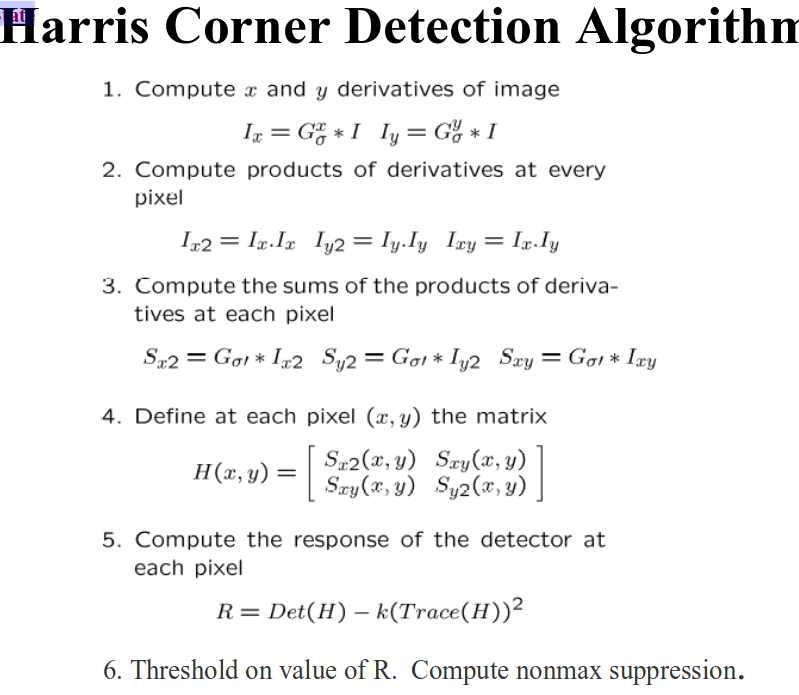
***

In [2]:
def gkern(l=3, sig=1.):
    """
    creates gaussian kernel with side length l and a sigma of sig
    """

    ax = np.arange(-l // 2 + 1., l // 2 + 1.)
    xx, yy = np.meshgrid(ax, ax)

    kernel = np.exp(-(xx**2 + yy**2) / (2. * sig**2))

    return kernel / np.sum(kernel)

In [3]:
def hariss_corner(I,kernel_size,sig,k,threshold,min_dist,color):
    d = np.array([1,0,-1]).reshape((3,1)) #difference filter
    f = gkern(kernel_size,sig)
    Gx = scipy.signal.convolve2d(f,d,mode="same")
    Gy = Gx.T
    
    
    Ix = scipy.signal.convolve2d(I[:,:,0],Gx,mode="same")
    Ix = nms(Ix,1.1)
    
    Iy = scipy.signal.convolve2d(I[:,:,0],Gy,mode="same")
    Iy = nms(Iy,1.1)
    
    Ix2 = np.square(Ix)
    Iy2 = np.square(Iy)
    Ixy = Ix*Iy
    
    Sx2 = scipy.signal.convolve2d(Ix2,f,mode="same")
    Sy2 = scipy.signal.convolve2d(Iy2,f,mode="same")
    Sxy = scipy.signal.convolve2d(Ixy,f,mode="same")
    
    H = np.array(([Sx2,Sxy],[Sxy,Sy2]))
    
    det = (Sx2 * Sy2) - (Sxy**2)
    
    R = det - 0.1*((np.trace(H))**2)
    
    Im_corner = get_corner(R,threshold,min_dist)
    
    plt.figure(figsize=(18,19),dpi=80)
    plt.plot([p[1] for p in Im_corner],[p[0] for p in Im_corner],'+',color=color)
    plt.imshow(I)

In [4]:
import scipy.signal

In [5]:
d = np.array([1,0,-1]).reshape((3,1))

In [6]:
f = gkern(3,2)
Gx = scipy.signal.convolve2d(f,d,mode="same")

In [7]:
Gy = Gx.T

In [8]:
img = cv2.imread('/home/n/images/r3.jpg')
I = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)


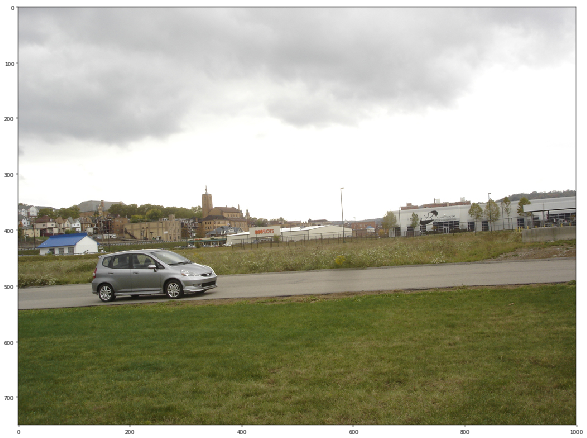

In [9]:
plt.figure(figsize=(18,19),dpi=40)
plt.imshow(I)

In [664]:
Ix = scipy.signal.convolve2d(I[:,:,0],Gx,mode="same")

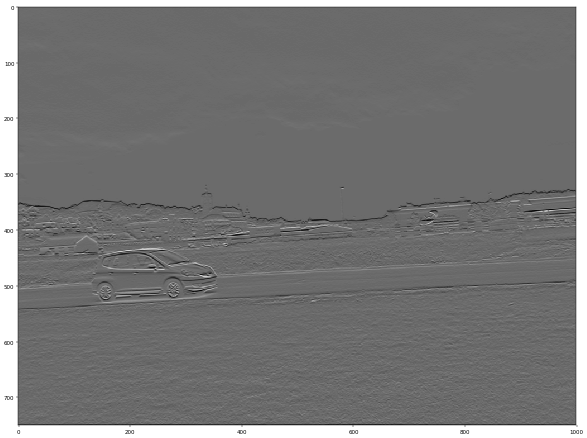

In [669]:
plt.figure(figsize=(18,19),dpi=40)
plt.imshow(Ix,cmap="gray")

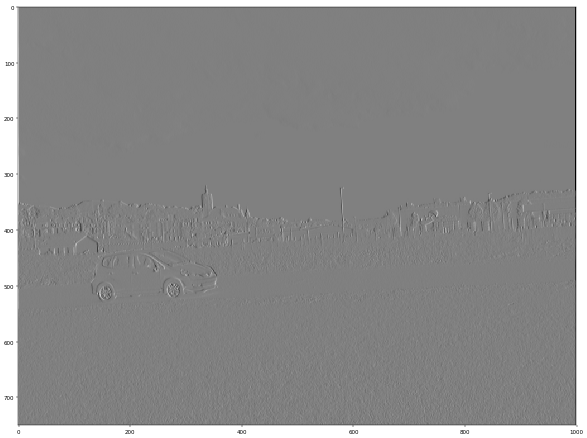

In [668]:
Iy = scipy.signal.convolve2d(I[:,:,0],Gy,mode="same")
plt.figure(figsize=(18,19),dpi=40)
plt.imshow(Iy,cmap="gray")

In [731]:
Ix2 = np.square(Ix)
Iy2 = np.square(Iy)
Ixy = Ix*Iy

In [734]:
Sx2 = scipy.signal.convolve2d(Ix2,f,mode="same")
Sy2 = scipy.signal.convolve2d(Iy2,f,mode="same")
Sxy = scipy.signal.convolve2d(Ixy,f,mode="same")

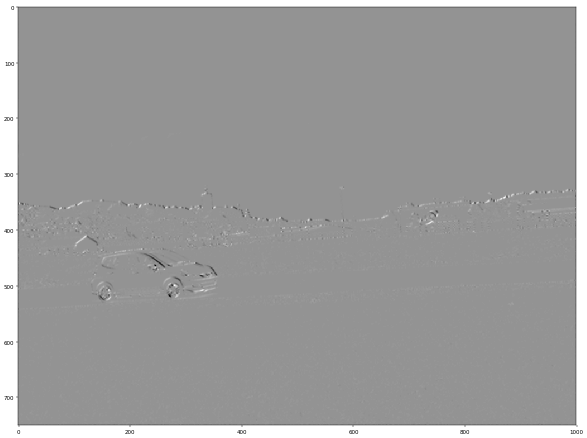

In [738]:
plt.figure(figsize=(18,19),dpi=40)
plt.imshow(Sxy,cmap="gray")

In [739]:
H = np.array(([Sx2,Sxy],[Sxy,Sy2]))

In [740]:
det = (Sx2 * Sy2) - (Sxy**2)

In [743]:
k = 0.1

In [744]:
R = det - 0.1*((np.trace(H))**2)

In [745]:
R

array([[ 2.25105766e+05,  3.48053141e+05, -2.06750325e+05, ...,
        -5.39379652e+05,  9.51715979e+05,  6.17690785e+05],
       [ 3.50827994e+05,  6.12615573e+05, -1.61067798e+05, ...,
        -4.20073243e+05,  1.64599030e+06,  9.52430078e+05],
       [-2.07373281e+05, -1.60817273e+05, -3.35266234e-01, ...,
         7.91947374e-03, -4.23005580e+05, -5.43433896e+05],
       ...,
       [-3.63973824e+03, -2.71248630e+03,  6.99807562e+00, ...,
         2.09623906e+01, -3.12713676e+03, -4.56269291e+03],
       [ 7.78022328e+03,  1.37346092e+04, -3.38033886e+03, ...,
        -4.45470703e+03,  1.55656344e+04,  7.70462587e+03],
       [ 5.30809228e+03,  8.23061016e+03, -4.65580383e+03, ...,
        -5.87690675e+03,  8.41336680e+03,  4.96480947e+03]])

In [795]:
r = det/(((np.trace(H))**2)*0.005)

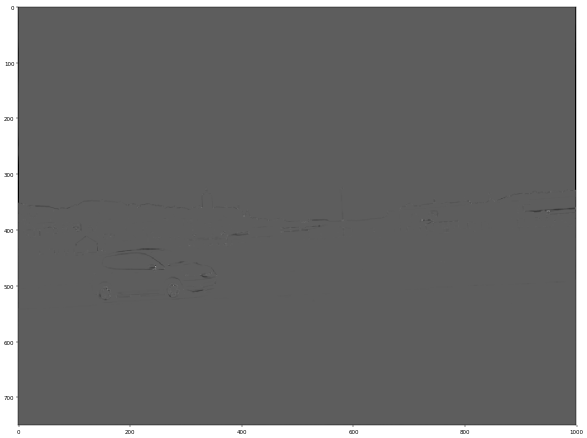

In [797]:
plt.figure(figsize=(18,19),dpi=40)
plt.imshow(R,cmap="gray")

In [847]:
corner_threshold = max(R.flatten()) * 0.01

In [848]:
corner_threshold

16459.90303262957

In [ ]:
# Get max value * threshold
# Keep all values higher than the vaue we get from above
# because we are taking values higher than threshold, there will be zeros, we only need non zeros


In [895]:
f = get_corner(R, 0.01,2)

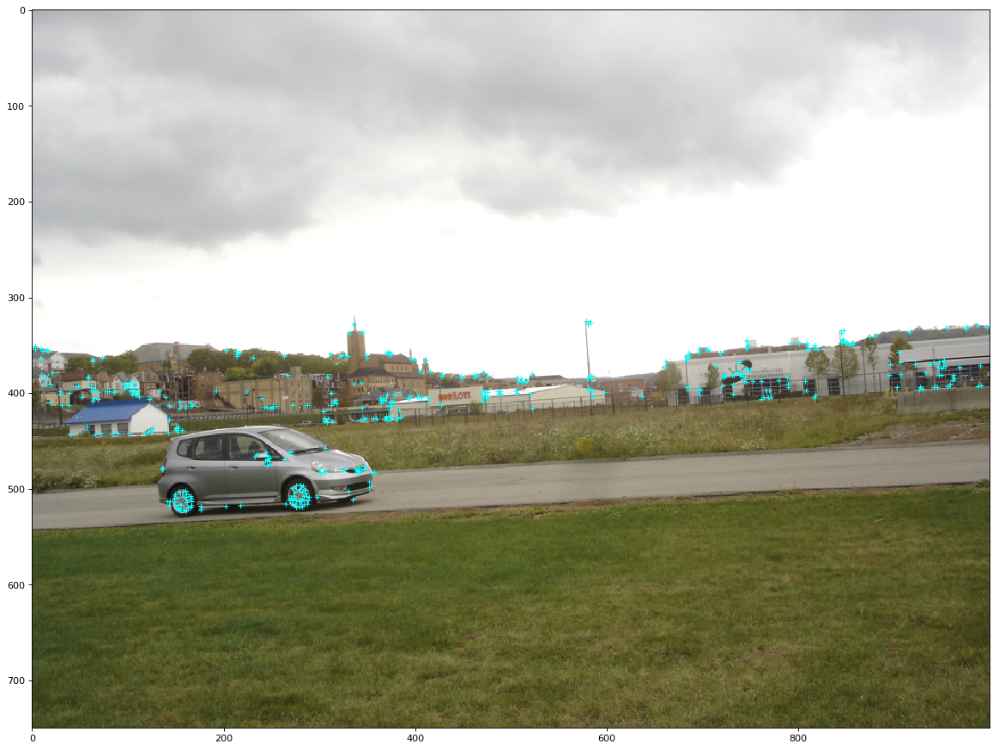

In [898]:
plt.figure(figsize=(18,19),dpi=80)
plt.plot([p[1] for p in f],[p[0] for p in f],'+',color="cyan")
plt.imshow(I)

In [10]:
def get_corner(resp_img,threshold,min_dist):
    corner_th = max(resp_img.flatten())*threshold #we calculate threshold
    imt = (resp_img>corner_th) # we filter values below threshold
    corner = imt.nonzero() # we eliminate values which are vacant and we get two array with location of values
    n_cords = [ (corner[0][c],corner[1][c]) for c in range(len(corner[0]))] #corner is 1d array because its faltten
    # corner[0] == corner[1] length, both contain location [1,4,5],[34,56,3]
    n_corners = [resp_img[c[0]][c[1]] for c in n_cords]
    # we have cords with threshold filter, and we pass this cords to response image to get feature i.e corners
    index = np.argsort(n_corners)# we get index sorted
    
    location_to_disp = np.zeros(resp_img.shape)
    location_to_disp[min_dist:-min_dist,min_dist:-min_dist] = 1
    filterted_location = []
    for i in index: #Index sorted for the best match feature
        if location_to_disp[n_cords[i][0]][n_cords[i][1]] == 1:
            filterted_location.append(n_cords[i])#from the matrix that we formed, the only corners will have one
            location_to_disp[(n_cords[i][0]-min_dist):(n_cords[i][0]+min_dist),
                (n_cords[i][1]-min_dist):(n_cords[i][1]+min_dist)] = 0 #we need to make distance between index 
            #since there are many corners detected and overlapped n_cords[i][0] will give the location, and subtracting
            #few pixels will help us getting over repeated features
    return filterted_location

#reference http://www.kaij.org/blog/?p=89

In [11]:
def hariss_corner(I,kernel_size,sig,k,threshold,min_dist,color):
    d = np.array([1,0,-1]).reshape((3,1)) #difference filter
    f = gkern(kernel_size,sig)
    Gx = scipy.signal.convolve2d(f,d,mode="same")
    Gy = Gx.T
    
    
    Ix = scipy.signal.convolve2d(I[:,:,0],Gx,mode="same")
    Ix = nms(Ix,1.1)
    Iy = scipy.signal.convolve2d(I[:,:,0],Gy,mode="same")
    Iy = nms(Iy,1.1)
    Ix2 = np.square(Ix)
    Iy2 = np.square(Iy)
    Ixy = Ix*Iy
    
    Sx2 = scipy.signal.convolve2d(Ix2,f,mode="same")
    Sy2 = scipy.signal.convolve2d(Iy2,f,mode="same")
    Sxy = scipy.signal.convolve2d(Ixy,f,mode="same")
    
    H = np.array(([Sx2,Sxy],[Sxy,Sy2]))
    
    det = (Sx2 * Sy2) - (Sxy**2)
    
    R = det - 0.04*((np.trace(H))**2)
    
    Im_corner = get_corner(R,threshold,min_dist)
    
    plt.figure(figsize=(18,19),dpi=80)
    plt.plot([p[1] for p in Im_corner],[p[0] for p in Im_corner],'+',color=color)
    plt.imshow(I)
    return Im_corner

In [50]:
img = cv2.imread('/home/n/images/house.bmp')
I = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)


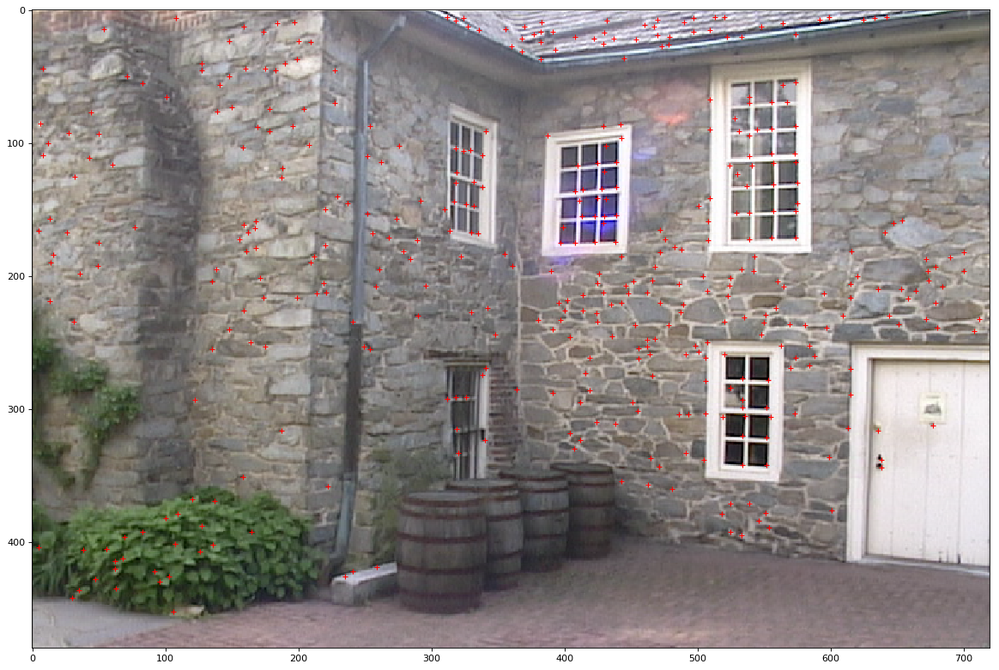

In [51]:
filtered_ = hariss_corner(I,3,2,2,0.001,5,"red")

# 4

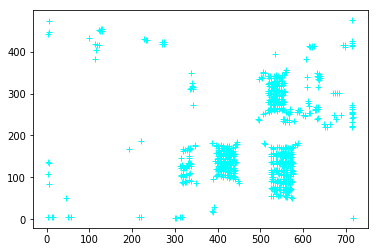

In [934]:
plt.plot([p[1] for p in filtered_],[p[0] for p in filtered_],'+',color="cyan")

In [13]:
len(filtered_)

669

In [14]:
filtered_

[(118, 536),
 (264, 569),
 (233, 566),
 (422, 271),
 (186, 220),
 (104, 320),
 (356, 560),
 (240, 553),
 (315, 610),
 (107, 530),
 (413, 625),
 (96, 390),
 (110, 541),
 (291, 524),
 (433, 100),
 (340, 635),
 (130, 317),
 (338, 547),
 (55, 557),
 (301, 675),
 (415, 694),
 (166, 328),
 (302, 684),
 (339, 610),
 (135, 552),
 (140, 395),
 (151, 540),
 (428, 232),
 (261, 588),
 (114, 402),
 (260, 556),
 (237, 497),
 (130, 420),
 (152, 406),
 (238, 678),
 (90, 546),
 (426, 714),
 (221, 651),
 (261, 593),
 (297, 520),
 (72, 532),
 (350, 339),
 (19, 386),
 (136, 422),
 (156, 546),
 (117, 525),
 (394, 534),
 (352, 506),
 (151, 417),
 (69, 570),
 (29, 392),
 (121, 326),
 (105, 549),
 (252, 507),
 (227, 650),
 (326, 340),
 (133, 5),
 (405, 115),
 (105, 326),
 (56, 525),
 (95, 527),
 (132, 530),
 (335, 498),
 (411, 698),
 (165, 323),
 (177, 409),
 (183, 509),
 (234, 554),
 (419, 114),
 (410, 620),
 (268, 631),
 (235, 579),
 (134, 544),
 (118, 319),
 (301, 679),
 (102, 397),
 (410, 616),
 (334, 634

In [348]:
v = extract_feature_vector(I,filtered_,5,3)

In [16]:

def extract_feature_vector(I,corners,w,c):
    W = int(np.floor(w/2))
    lol = []
    cords = []
    i = 0
    if c == 1:
        I = I[:,:,0]
        j = np.zeros((len(corners),w**2))
    elif c == 2:
        I = I[:,:,0:2]
        j = np.zeros((len(corners),w**2,c))
    else:
        I = I
        j = np.zeros((len(corners),w**2,3))
    for v in corners:
        lol = []
        
        xc = [(v[0]+i) for i in range(-W,W+1)]
        yc = [(v[1]+i) for i in range(-W,W+1)]
        for x in xc:
            for y in yc:

                lol.append(I[x][y])
        cords.append((v[0],v[1]))
        k = np.array(lol)
        j[i] = k
        k = 0
        i = i+1
    return j,cords

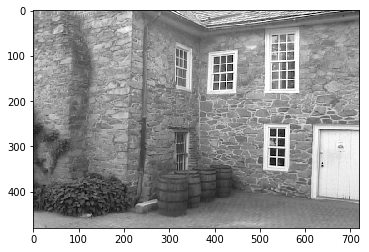

In [1000]:
plt.imshow(I[:,:,0],cmap="gray")

In [17]:
img = cv2.imread('/home/n/images/sample-a.jpg')
I1 = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
img = cv2.imread('/home/n/images/sample-b.jpg')
I2 = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

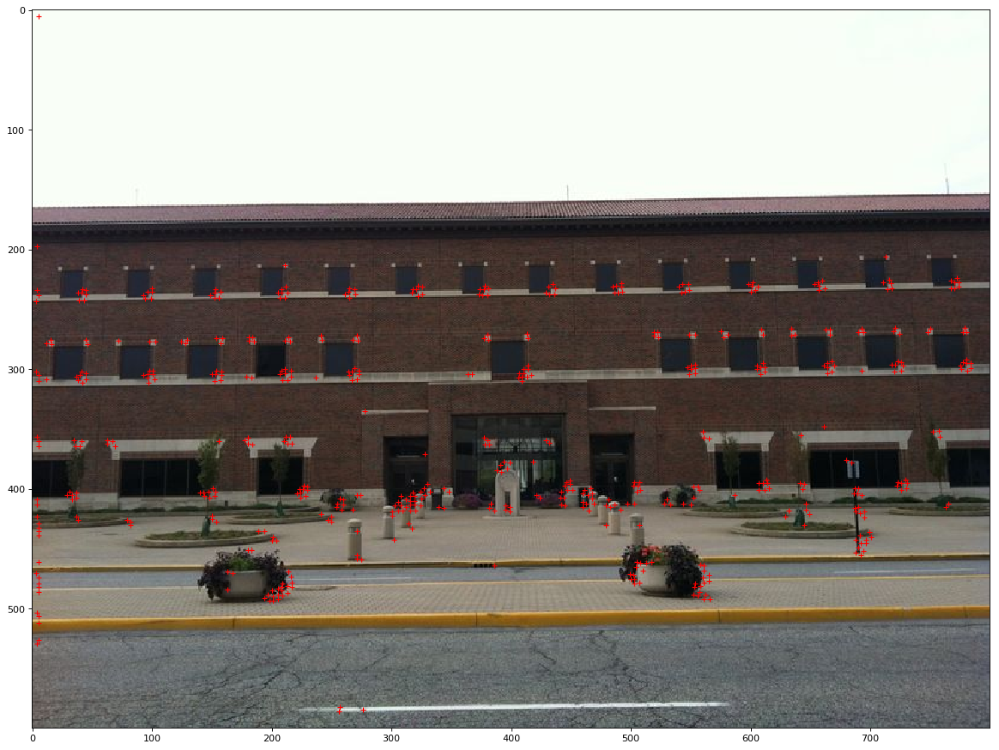

In [18]:
f_1 = hariss_corner(I1,11,2,10,0.0005,3,"red")

In [19]:
f_1

[(231, 212),
 (433, 317),
 (419, 301),
 (239, 322),
 (395, 607),
 (359, 429),
 (486, 557),
 (461, 517),
 (356, 758),
 (307, 183),
 (394, 507),
 (412, 497),
 (405, 271),
 (408, 257),
 (412, 765),
 (296, 554),
 (416, 687),
 (485, 200),
 (271, 581),
 (294, 777),
 (473, 216),
 (415, 483),
 (228, 492),
 (271, 554),
 (413, 260),
 (474, 5),
 (405, 274),
 (295, 610),
 (586, 256),
 (423, 37),
 (396, 645),
 (423, 4),
 (229, 435),
 (418, 316),
 (308, 12),
 (488, 197),
 (403, 140),
 (240, 156),
 (407, 148),
 (357, 377),
 (477, 565),
 (232, 100),
 (492, 205),
 (435, 194),
 (231, 606),
 (243, 3),
 (461, 5),
 (237, 326),
 (378, 684),
 (295, 784),
 (418, 632),
 (225, 716),
 (226, 660),
 (394, 446),
 (405, 464),
 (277, 103),
 (233, 42),
 (309, 267),
 (452, 694),
 (269, 777),
 (526, 5),
 (348, 661),
 (232, 718),
 (440, 201),
 (413, 550),
 (488, 562),
 (232, 767),
 (278, 157),
 (423, 250),
 (405, 328),
 (401, 612),
 (405, 587),
 (442, 302),
 (430, 645),
 (394, 503),
 (459, 275),
 (429, 5),
 (419, 688),
 

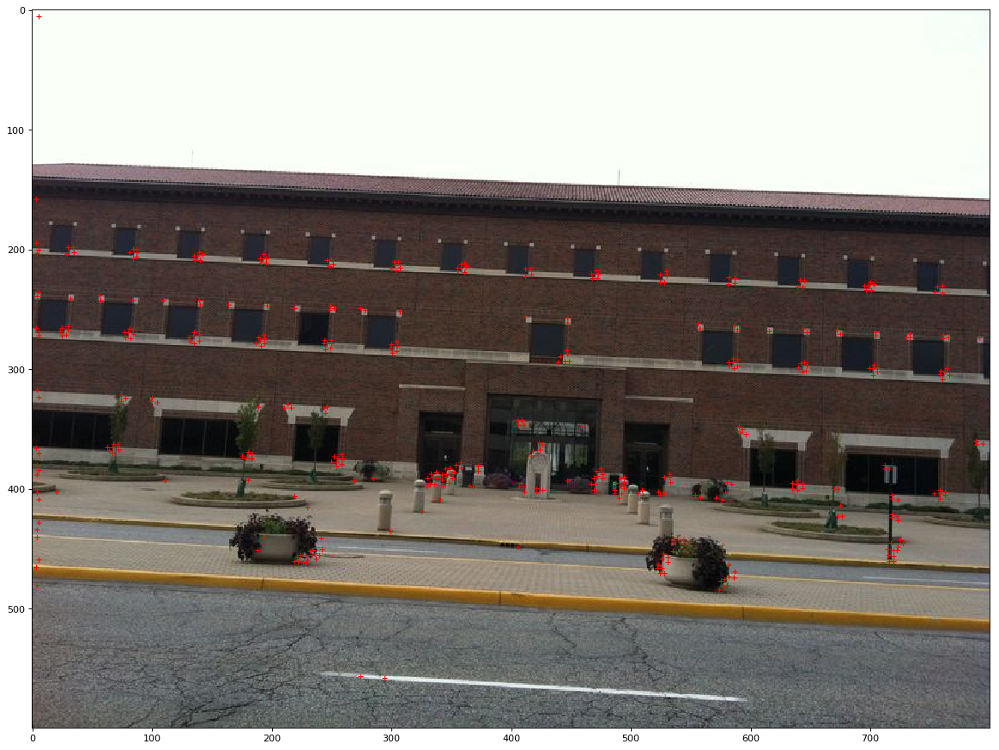

In [60]:
f_2 = hariss_corner(I2,11,2,10,0.001,3,"red")

In [20]:
V_1,c1 = extract_feature_vector(I1,f_1,5,3)

In [61]:
V_2,c2 = extract_feature_vector(I2,f_2,5,3)

In [214]:
V_1[0]

array([[ 95.,  81.,  52.],
       [ 83.,  67.,  41.],
       [136., 120.,  94.],
       [105.,  97.,  60.],
       [100.,  92.,  55.],
       [135., 130.,  98.],
       [128., 115.,  83.],
       [129., 114.,  85.],
       [132., 117.,  94.]])

In [215]:
c2[0]

(349, 746)

In [216]:
V_2[0]

array([[241., 237., 238.],
       [138., 135., 130.],
       [232., 231., 227.],
       [246., 244., 245.],
       [143., 139., 136.],
       [231., 230., 225.],
       [254., 250., 249.],
       [143., 138., 132.],
       [221., 221., 213.]])

In [133]:
m = []
v = []
loc = []
d = 0

In [134]:
for v1,c_1 in zip(V_1,c1):
    for v2,c_2 in zip(V_2,c2):
        d = np.linalg.norm(v1-v2)
        m.append((v1,v2)) # Clossest vectors
        v.append((d)) # Nearest distance
        loc.append((c_1,c_2)) #coordinates responding to the location

        d = 0

In [135]:
len(m)

110223

In [361]:
# import pdb
# def comapred_features(features_Vectors1,cords_im1,features_Vectors2,cords_im2):
#     m = []
#     v = []
#     loc = []
#     co = []
#     d = 0
#     di = []
#     for v1,c_1 in zip(features_Vectors1,cords_im1):
#         for v2,c_2 in zip(features_Vectors2,cords_im2):
#             d = np.sum(np.square(v1-v2))
#             pdb.set_trace()
#             m.append((v1,v2)) # Clossest vectors
#             v.append((d)) # Nearest distance
#             loc.append((c_1,c_2)) #coordinates responding to the location
#             d = 0
#         lol = np.argmin(v)
#         di.append(v[lol])
#         co.append(loc[lol])
        
            
#     return co,di


In [90]:
def comapred_features(features_Vectors1,cords_im1,features_Vectors2,cords_im2):
    dis = []
    loc = []
    cords = []
    s = []
    for v1,c_1 in zip(V_1,c1):
        for v2,c_2 in zip(V_2,c2):
            d = np.sqrt(np.sum(np.square(v2-v1)))
            dis.append(d)
            loc.append((c_1,c_2))
        q = np.argmin(dis)
        cords.append(loc[q])
        s.append(dis[q])
        dis = []
        loc = []
    return cords,s

In [548]:
dis = []
loc = []
cords = []
s = []
for v1,c_1 in zip(V_1,c1):
    for v2,c_2 in zip(V_2,c2):
        d = np.sqrt(np.sum(np.square(v2-v1)))
        dis.append(d)
        loc.append((c_1,c_2))
    q = np.argmin(dis)
    cords.append(loc[q])
    s.append(dis[q])
    dis = []
    loc = []

In [549]:
cords

[((304, 5), (195, 4)),
 ((361, 432), (409, 339)),
 ((426, 79), (483, 577)),
 ((421, 649), (422, 676)),
 ((586, 256), (474, 585)),
 ((267, 609), (299, 705)),
 ((429, 314), (409, 339)),
 ((399, 327), (275, 244)),
 ((486, 199), (295, 582)),
 ((421, 303), (380, 256)),
 ((351, 752), (396, 638)),
 ((309, 11), (301, 646)),
 ((233, 42), (277, 303)),
 ((234, 262), (205, 136)),
 ((393, 449), (230, 759)),
 ((306, 158), (289, 447)),
 ((415, 483), (395, 348)),
 ((213, 211), (269, 704)),
 ((440, 201), (461, 226)),
 ((413, 260), (195, 4)),
 ((236, 437), (203, 34)),
 ((439, 300), (409, 339)),
 ((410, 480), (392, 342)),
 ((233, 318), (215, 356)),
 ((423, 4), (158, 3)),
 ((240, 5), (227, 587)),
 ((226, 767), (268, 78)),
 ((229, 435), (218, 529)),
 ((406, 327), (268, 4)),
 ((435, 194), (405, 220)),
 ((337, 276), (234, 701)),
 ((412, 382), (215, 356)),
 ((232, 100), (211, 361)),
 ((399, 346), (213, 306)),
 ((301, 726), (450, 723)),
 ((422, 150), (421, 720)),
 ((418, 396), (376, 259)),
 ((423, 630), (445, 

In [496]:
s

[57.59340239992772,
 131.77632564311392,
 112.73420066687837,
 67.34240862933252,
 184.64019064114942,
 128.2107639786925,
 124.6755790040696,
 124.2014492669067,
 108.3512805646523,
 171.49344010777787,
 178.69806937961025,
 151.50907563575194,
 78.7273777030583,
 91.45490692138941,
 157.52460125326456,
 156.88212135230705,
 127.28707711311466,
 199.56452590578317,
 36.27671429443411,
 69.06518659932803,
 48.8978527135906,
 124.51505933018704,
 88.07383266328314,
 61.0163912403872,
 224.0,
 58.0,
 29.32575659723036,
 252.46980017419907,
 102.32301793829187,
 90.43782394551519,
 68.25686778632608,
 230.7531148218806,
 112.6765281680262,
 95.39916142189091,
 139.5456914419073,
 30.789608636681304,
 99.13122616007531,
 197.59807691371898,
 166.30694513459142,
 243.69653259740895,
 177.9606698121807,
 76.32823854904552,
 105.24732775705044,
 32.2490309931942,
 63.2771680782255,
 108.04628637764465,
 214.66718426438635,
 78.0,
 87.45284443630179,
 133.79835574475496,
 92.0869154657707,
 11

In [362]:
cords = comapred_features(V_1,c1,V_2,c2)

> <ipython-input-361-40ee30a75a18>(13)comapred_features()
-> m.append((v1,v2)) # Clossest vectors
(Pdb) d
*** Newest frame
(Pdb) q


BdbQuit: 

In [358]:
cords

([((308, 379), (291, 411)),
  ((308, 379), (291, 411)),
  ((308, 379), (291, 411)),
  ((308, 379), (291, 411)),
  ((308, 379), (291, 411)),
  ((308, 379), (291, 411)),
  ((308, 379), (291, 411)),
  ((308, 379), (291, 411)),
  ((308, 379), (291, 411)),
  ((308, 379), (291, 411)),
  ((308, 379), (291, 411)),
  ((308, 379), (291, 411)),
  ((308, 379), (291, 411)),
  ((308, 379), (291, 411)),
  ((308, 379), (291, 411)),
  ((308, 379), (291, 411)),
  ((308, 379), (291, 411)),
  ((308, 379), (291, 411)),
  ((308, 379), (291, 411)),
  ((308, 379), (291, 411)),
  ((308, 379), (291, 411)),
  ((308, 379), (291, 411)),
  ((308, 379), (291, 411)),
  ((308, 379), (291, 411)),
  ((308, 379), (291, 411)),
  ((308, 379), (291, 411)),
  ((308, 379), (291, 411)),
  ((308, 379), (291, 411)),
  ((308, 379), (291, 411)),
  ((308, 379), (291, 411)),
  ((308, 379), (291, 411)),
  ((308, 379), (291, 411)),
  ((308, 379), (291, 411)),
  ((308, 379), (291, 411)),
  ((308, 379), (291, 411)),
  ((308, 379), (291,

In [271]:
# def comapred_features(features_Vectors1,cords_im1,features_Vectors2,cords_im2):
#     m = []
#     v = []
#     loc = []
#     d = 0
#     for v1,v2,c_1,c_2 in zip(features_Vectors1,features_Vectors2,cords_im1,cords_im2):
#         d = np.linalg.norm(v1-v2)
#         m.append((v1,v2)) # Clossest vectors
#         v.append((d)) # Nearest distance
#         loc.append((c_1,c_2)) #coordinates responding to the location

#         d = 0
#     return v,loc,m


In [326]:
q,w,e = comapred_features(V_1,c1,V_2,c2)

In [201]:
len(w)

331

In [139]:
v[0]

262.5509474368737

In [140]:
loc[0][1]

(209, 138)

In [141]:
np.linalg.norm(V_1[0]-V_2[0])

262.5509474368737

In [142]:
vv = np.array(v)

In [143]:
vv.sort()

In [144]:
v[0]

262.5509474368737

In [145]:
m[0]

(array([[154., 151., 134.],
        [140., 137., 120.],
        [141., 138., 121.],
        [156., 150., 136.],
        [145., 139., 125.],
        [144., 138., 124.],
        [148., 142., 128.],
        [141., 135., 121.],
        [139., 133., 119.]]), array([[ 95.,  90.,  87.],
        [105., 100.,  97.],
        [124., 119., 115.],
        [141., 134., 128.],
        [143., 136., 130.],
        [151., 144., 138.],
        [ 61.,  52.,  47.],
        [ 62.,  53.,  48.],
        [ 69.,  60.,  55.]]))

In [409]:
numpy_horizontal = np.vstack((I1, I2))

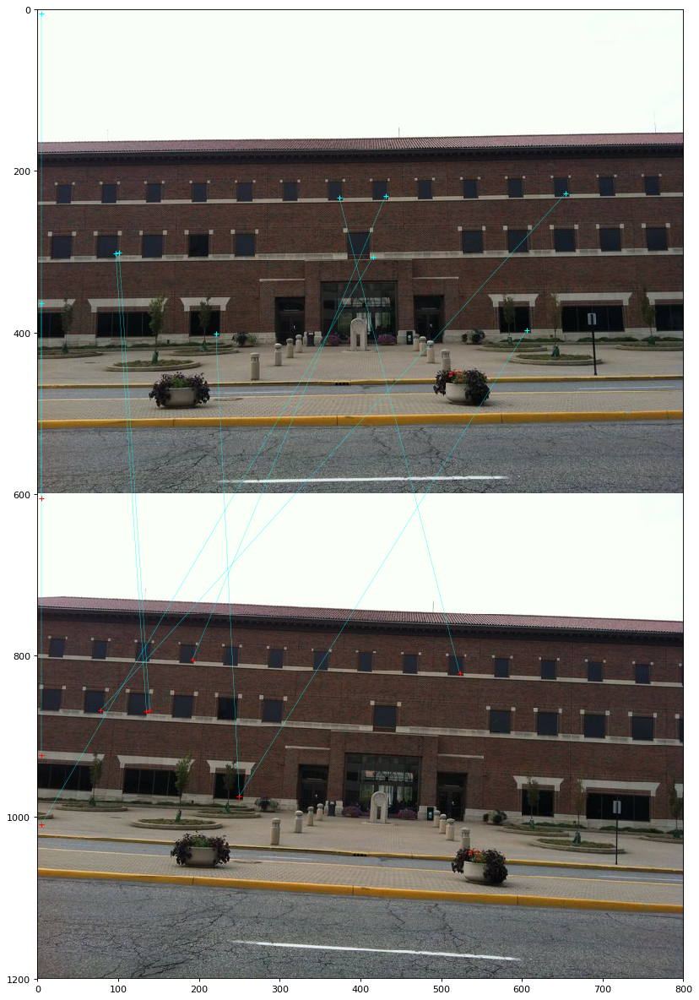

In [560]:

plt.figure(figsize=(18,19),dpi=80)
plt.plot([p[0][1] for p in required[:,[0]]],[p[0][0] for p in required[:,[0]]],'+',color="cyan")
plt.plot([p[0][1] for p in required[:,[1]]],[p[0][0] for p in required[:,[1]]],'+',color="red")
plt.plot([[p[0] for p in required[:,[0],[1]]],[p[0] for p in required[:,[1],[1]]]],[[p[0] for p in required[:,[0],[0]]],[p[0] for p in required[:,[1],[0]]]],color="cyan",linewidth=0.3)


plt.imshow(numpy_horizontal)

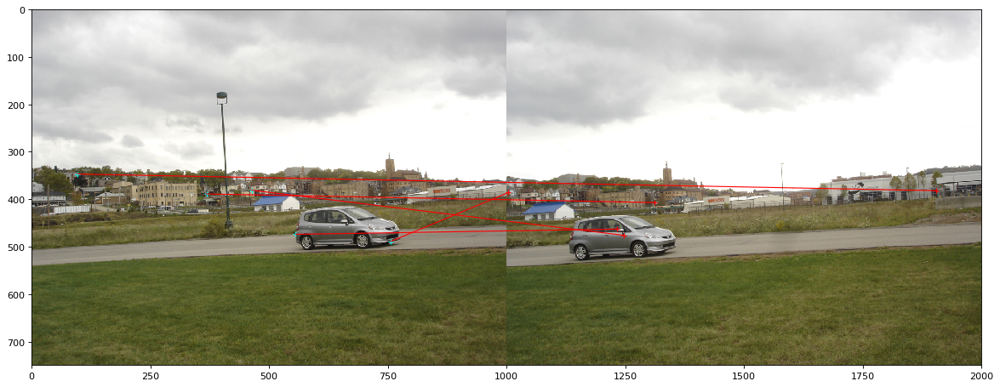

In [320]:
plt.figure(figsize=(18,19),dpi=80)
plt.plot([p[0][1] for p in lol[:,[0]]],[p[0][0] for p in lol[:,[0]]],'+',color="cyan")
plt.plot([p[0][1] for p in lol[:,[1]]],[p[0][0] for p in lol[:,[1]]],'+',color="red")
plt.plot([[p[0] for p in lol[:,[0],[1]]],[p[0] for p in lol[:,[1],[1]]]],[[p[0] for p in lol[:,[0],[0]]],[p[0] for p in lol[:,[1],[0]]]],color="red",linewidth=1)


plt.imshow(numpy_horizontal)

In [221]:
numpy_horizontal = np.hstack((I1, I2))

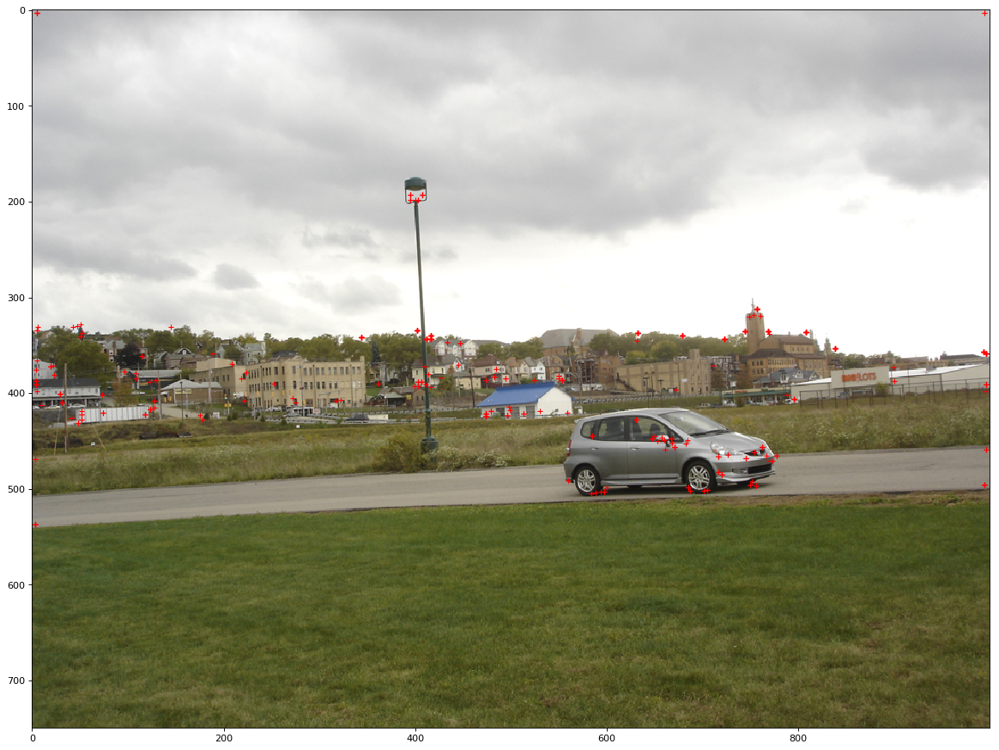

In [341]:
plt.figure(figsize=(18,19),dpi=80)
plt.plot([p[0][1] for p in required[:,[0]]],[p[0][0] for p in required[:,[0]]],'+',color="red")
plt.imshow(I1)

In [193]:
cc = np.argsort(v)

In [95]:
def get_matches(distance,cords,n):
    cc = np.argsort(distance)
    ccc = np.array(cc[:n])
    loc = np.array(cords)
    required = loc[ccc]
    uuu = np.zeros((n,1,2))
    uuu[:,[0]] = (0,1000)
    uu = required[:,[1]]
    co = uu+ uuu
    required[:,[1]] = co
    return required
    
    
    
    

In [479]:
sortlst

[5.196152422706632,
 5.5677643628300215,
 7.280109889280518,
 9.9498743710662,
 9.9498743710662,
 15.905973720586866,
 17.46424919657298,
 17.4928556845359,
 18.193405398660254,
 18.894443627691185,
 19.87460691435179,
 20.12461179749811,
 20.615528128088304,
 20.639767440550294,
 22.627416997969522,
 23.130067012440755,
 23.15167380558045,
 23.57965224510319,
 23.811761799581316,
 24.041630560342615,
 24.166091947189145,
 24.228082879171435,
 24.43358344574123,
 24.677925358506133,
 24.879710609249457,
 24.879710609249457,
 24.939927826679853,
 25.337718918639855,
 25.632011235952593,
 26.419689627245813,
 26.832815729997478,
 27.09243436828813,
 27.23967694375247,
 27.27636339397171,
 27.422618401604176,
 27.51363298439521,
 28.071337695236398,
 28.26658805020514,
 29.24038303442689,
 29.427877939124322,
 29.715315916207253,
 29.816103031751148,
 30.099833886584822,
 30.28200785945344,
 30.331501776206203,
 30.577769702841312,
 30.708305065568176,
 30.773365106858236,
 30.83828789021

In [480]:
inx[:5]

array([309, 308, 294, 316, 307])

In [482]:
s[309]

5.196152422706632

In [467]:
sortlst = sorted(s)

In [550]:
inx = np.argsort(s)

In [551]:
ccc = np.array(inx[:10])

In [552]:
loc = np.array(cords)

In [553]:
required = loc[ccc]

In [554]:
uuu = np.zeros((10,1,2))

In [555]:
uuu[:,[0]] = (600,0)

In [556]:
uu = required[:,[1]]

In [557]:
co = uu+ uuu

In [558]:
required[:,[1]] = co

In [559]:
required

array([[[   5,    5],
        [ 605,    5]],

       [[ 401,  221],
        [ 974,  250]],

       [[ 302,   97],
        [ 869,  135]],

       [[ 397,  606],
        [ 974,  250]],

       [[ 301,  101],
        [ 868,  139]],

       [[ 233,  374],
        [ 822,  523]],

       [[ 231,  431],
        [ 805,  192]],

       [[ 306,  416],
        [1009,    5]],

       [[ 228,  654],
        [ 868,   78]],

       [[ 364,    5],
        [ 923,    5]]])

In [319]:
lol = required

In [170]:
len(cc)

110223

In [171]:
len(loc)

110223

In [172]:
I1.shape

(600, 800, 3)

In [173]:
ccc = np.array(cc[:150])

In [174]:
v[21126]

241.44357518890413

In [175]:
f2 = np.add(f_2,(6000,0))

In [176]:
loc = np.array(loc)

In [177]:
required = loc[ccc]

In [178]:
required[1]

array([[  5,   3],
       [124,   5]])

In [179]:
uuu = np.zeros((150,1,2))

In [180]:
uuu[:,[0]] = (600,0)

In [181]:
uu = required[:,[1]] #required[:,[0]]

In [182]:
co = uu+ uuu

In [183]:
required.shape

(150, 2, 2)

In [184]:
required[:,[1]] = co

In [247]:
lol = get_matches(q,w,5)

In [192]:
lol

array([[[   5,    3],
        [   3, 1005]],

       [[   5,    3],
        [ 124, 1005]],

       [[ 148,  794],
        [   3, 1794]],

       [[   3,  794],
        [   3, 1005]],

       [[   3,  794],
        [ 124, 1005]],

       [[ 148,  794],
        [ 153, 1794]],

       [[ 362,  182],
        [ 333, 1215]],

       [[   3,  794],
        [   3, 1794]],

       [[ 231,  693],
        [ 323, 1003]],

       [[ 355,  614],
        [ 325, 1076]],

       [[ 405,  337],
        [ 386, 1361]],

       [[ 160,    4],
        [   3, 1005]],

       [[ 160,    4],
        [ 124, 1005]],

       [[ 451,  795],
        [ 355, 1646]],

       [[ 231,  693],
        [ 437, 1795]],

       [[ 366,  567],
        [ 371, 1003]],

       [[   3,  794],
        [ 153, 1794]],

       [[ 427,  795],
        [ 437, 1795]],

       [[ 353,  795],
        [ 361, 1792]],

       [[ 355,  614],
        [ 355, 1646]],

       [[ 356,  563],
        [ 355, 1646]],

       [[ 356,  563],
        [ 32

# 4.2

# 4.3

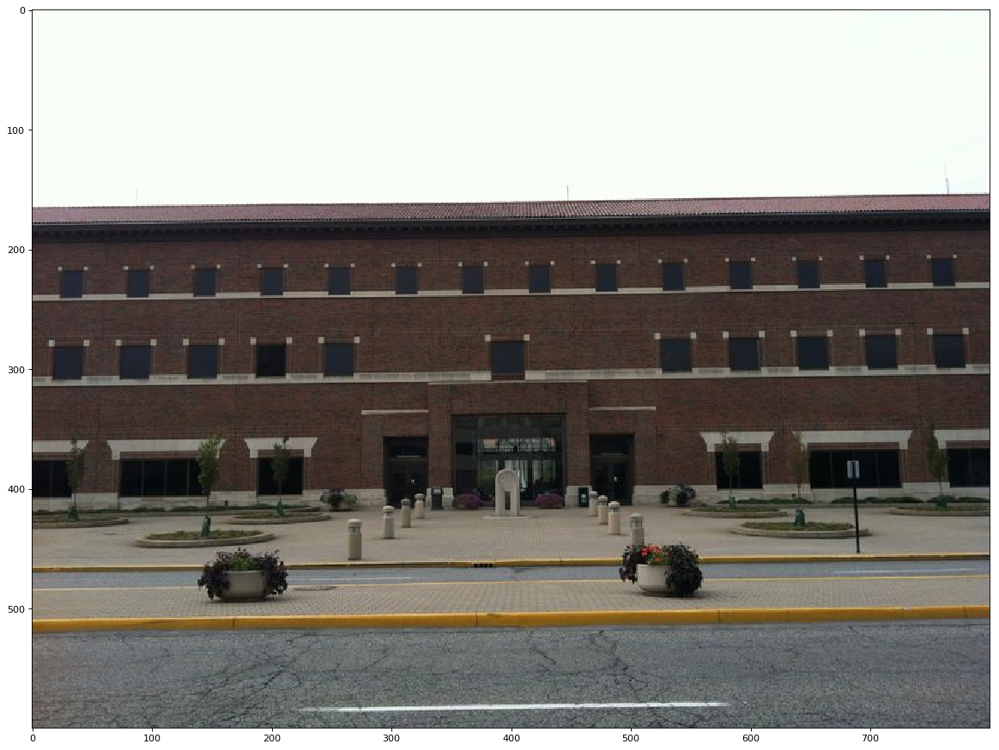

In [176]:
plt.figure(figsize=(18,19),dpi=80)

plt.imshow(I1)

In [177]:
img = cv2.imread('/home/n/images/r2.jpg')
I1 = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

In [178]:
import cv2
print (cv2.__version__)

3.4.0


In [179]:
import cv2
import numpy as np

img1 = cv2.imread('/home/n/images/sample-a.jpg')
gray1= cv2.cvtColor(img1,cv2.COLOR_BGR2GRAY)
img2 = cv2.imread('/home/n/images/sample-b.jpg')
gray2 = cv2.cvtColor(img2,cv2.COLOR_BGR2GRAY)

sift = cv2.xfeatures2d.SIFT_create()
kp1, des1 = sift.detectAndCompute(gray1,None)
kp2, des2 = sift.detectAndCompute(gray2,None)
# kpimg = cv2.drawKeypoints(gray, kp, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)    
# plt.figure(figsize=(18,19),dpi=80)

# plt.imshow(kpimg)

In [180]:
im1cords = 0
im2cords = 0

In [181]:
im1cords = [p.pt for p in kp1]
im2cords = [p.pt for p in kp2]

In [936]:
dis = []
loc = []
cords = []
s = []
for v1,c_1 in zip(V_1,c1):
    for v2,c_2 in zip(V_2,c2):
        d = np.sqrt(np.sum(np.square(v2-v1)))
        dis.append(d)
        loc.append((c_1,c_2))
    q = np.argmin(dis)
    cords.append(loc[q])
    s.append(dis[q])
    dis = []
    loc = []

NameError: name 'V_1' is not defined

In [935]:
s

[]

In [195]:
def get_matches(distance,cords,n):
    cc = np.argsort(distance)
    ccc = np.array(cc[:n])
    loc = np.array(cords)
    required = loc[ccc]
    uuu = np.zeros((n,1,2))
    uuu[:,[0]] = (0,800)
    uu = required[:,[1]]
    co = uu+ uuu
    required[:,[1]] = co
    return required
    

In [196]:
gray1.shape

(600, 800)

In [197]:
lol = get_matches(s,cords,50)

In [36]:
u[j]

array([[[187.34115601, 364.3883667 ],
        [211.87391663, 214.00764465]],

       [[662.67199707, 415.22689819],
        [712.33630371, 352.48135376]],

       [[615.83673096, 401.8303833 ],
        [671.28479004, 472.78012085]],

       [[648.83880615, 357.63284302],
        [700.94946289, 409.58035278]],

       [[379.02371216, 586.39422607],
        [418.61431885, 362.44036865]],

       [[554.34820557, 303.78826904],
        [608.70587158, 431.39520264]],

       [[579.90350342, 303.39572144],
        [634.92053223, 419.0116272 ]],

       [[698.29595947, 426.11862183],
        [753.31842041, 413.92584229]],

       [[535.71704102, 400.45556641],
        [590.86962891, 351.66156006]],

       [[233.66989136, 406.73721313],
        [277.1847229 , 339.92089844]],

       [[450.43728638, 402.46237183],
        [498.09490967, 469.01385498]],

       [[611.82818604, 302.95236206],
        [678.45788574, 593.88244629]],

       [[130.97714233, 364.11743164],
        [165.01026917, 413

In [39]:
s3 = np.array(s)

In [40]:
s3 = s[j]

TypeError: only integer scalar arrays can be converted to a scalar index

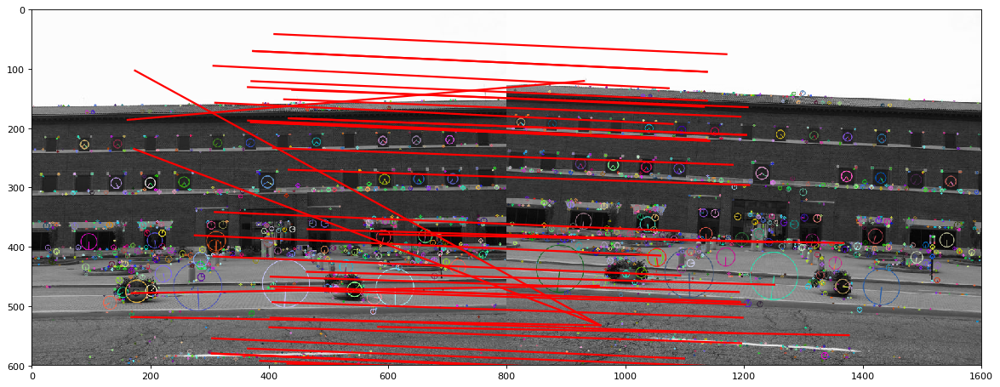

In [200]:
plt.figure(figsize=(18,19),dpi=80)
kpimg = cv2.drawKeypoints(gray1, kp1, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
kpimg2 = cv2.drawKeypoints(gray2, kp2, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
numpy_horizontal = np.hstack((kpimg,kpimg2))


plt.plot([[p[0] for p in lol[:,[0],[1]]],[p[0] for p in lol[:,[1],[1]]]],[[p[0] for p in lol[:,[0],[0]]],[p[0] for p in lol[:,[1],[0]]]],color="red",linewidth=2)
plt.imshow(numpy_horizontal,cmap="gray")

In [46]:
numpy_horizontal = np.hstack((gray1,gray2))

In [192]:
plt.figure(figsize=(18,19),dpi=80)
kpimg = cv2.drawKeypoints(gray1, kp1, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
kpimg2 = cv2.drawKeypoints(gray2, kp2, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
numpy_horizontal = np.hstack((kpimg,kpimg2))


plt.plot([[p[0] for p in lol[:,[0],[1]]],[p[0] for p in lol[:,[1],[1]]]],[[p[0] for p in lol[:,[0],[0]]],[p[0] for p in lol[:,[1],[0]]]],color="cyan",linewidth=0.2)
plt.imshow(numpy_horizontal,cmap="gray")

TypeError: list indices must be integers or slices, not tuple

In [120]:
def get_matches(distance,cords,n):
    cc = np.argsort(distance)
    ccc = np.array(cc[:n])
    loc = np.array(cords)
    required = loc[ccc]
    uuu = np.zeros((n,1,2))
    uuu[:,[0]] = (0,1000)
    uu = required[:,[1]]
    co = uu+ uuu
    required[:,[1]] = co
    return required
    
    

# 5.1

In [11]:
import cv2

def click_event(event, x, y, flags, param):
	if event == cv2.EVENT_LBUTTONDOWN:
		print( x, y)
	if event == cv2.EVENT_RBUTTONDOWN:
		red = img[y,x,2]
		blue = img[y,x,0]
		green = img[y,x,1]
		print( red, green, blue)
		strRGB = str(red) + "," + str(green) + "," +str(blue)
		font = cv2.FONT_HERSHEY_SIMPLEX
		cv2.putText(img,strRGB,(x,y), font, 1,(255,255,255),2)
		cv2.imshow('original', img)	
		
img = I1
cv2.imshow('original', img)



cv2.setMouseCallback("original", click_event)
cv2.waitKey(0)

cv2.destroyAllWindows

512 317
512 317
512 317
512 317
512 317
512 317
512 317
512 317
512 317
222 226 227
203 274
203 274
279 125
208 208 208


<function destroyAllWindows>

In [28]:
img = cv2.imread('/home/n/images/floor.png')
I1 = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
image = I1

In [29]:
import cv2 


def clickEvent(event,x,y,flags,param):
    global op 

    if event == cv2.EVENT_LBUTTONDBLCLK:
        print(x,y)

        
        op.append((x,y))
    

WINDOW_NAME = "win"

image = I1
cv2.namedWindow(WINDOW_NAME, cv2.WINDOW_AUTOSIZE)
# initialtime = time.time()

cv2.startWindowThread()
cv2.imshow(WINDOW_NAME, image)
# cv.waitKey(1000)
cv2.setMouseCallback("win", clickEvent)
# cv.waitKey(1)
# cv.destroyAllWindows()
c = cv2.waitKey(0)
if 'q' == chr(c & 255):
    cv2.destroyAllWindows()


175 150
363 125
419 295
166 313


In [30]:
op

[(175, 150), (363, 125), (419, 295), (166, 313)]

In [78]:
def convert_rectangle(img,points):
    points = np.array(points)
    points[1][1] = points[0][1]
    points[2][0] = points[1][0]
    points[3][0] = points[0][0]
    points[3][1] = points[2][1]
    c =img[points[0][1]:points[2][1],points[0][0]:points[1][0]]
    plt.imshow(c,cmap="gray")
    
    return points,c

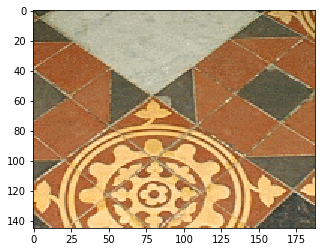

In [32]:
pp,c = convert_rectangle(I1,op)

In [77]:
c.shape

(231, 314, 3)

# 5.2

In [11]:
def gethomography(p1, p2):
    p1 = np.array(p1)
    p2 = np.array(p2)
    lol = []
    for i in range(4):
        x, y = p1[i][0], p1[i][1]
        u, v = p2[i][0], p2[i][1]
        lol.append([x, y, 1, 0, 0, 0, -u*x, -u*y, -u])
        lol.append([0, 0, 0, x, y, 1, -v*x, -v*y, -v])
    lol = np.array(lol)
    U, S, v = np.linalg.svd(lol)
    L = v[-1,:] / v[-1,-1]
    H = L.reshape(3, 3)
    return H


In [34]:
H = gethomography(op,pp)

In [35]:
o = cv2.warpPerspective(I1,H,(305, 344))

In [17]:
H1

array([[ 3.60843672e-01, -2.35128975e-01,  1.72152579e+02],
       [-1.49839285e-01,  3.91922497e-01,  1.26937675e+02],
       [-5.88399447e-04, -4.75969585e-04,  1.00000000e+00]])

In [36]:
H2

array([[ 2.02978972e+00,  6.95857737e-01, -1.61747271e+02],
       [ 4.32598039e-01,  2.52199947e+00, -1.98709215e+02],
       [ 1.09985177e-03,  3.39663349e-03,  1.00000000e+00]])

In [18]:
pp

array([[369, 276],
       [494, 276],
       [494, 334],
       [369, 334]])

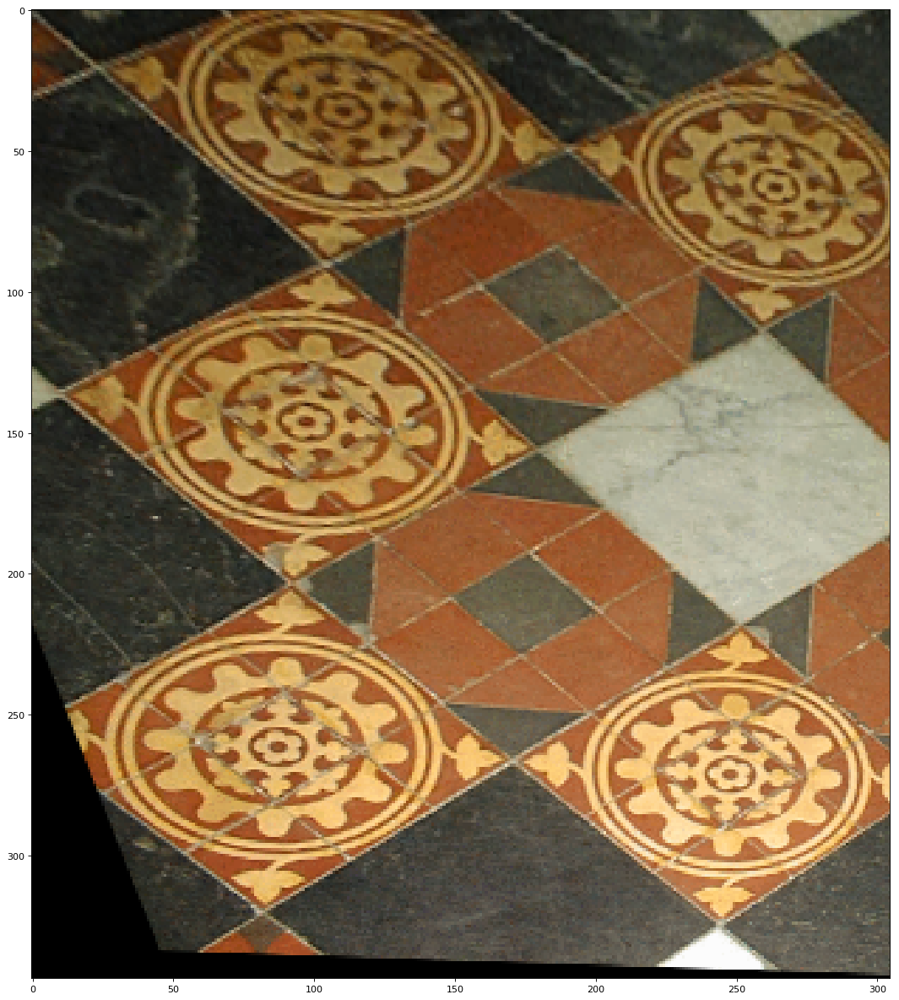

In [37]:
plt.figure(figsize=(18,19),dpi=80)

plt.imshow(o,cmap="gray")

In [56]:
H.shape
op = np.array(op)

In [57]:
op.shape

(4, 2)

In [10]:
def calculteXY(p_old,H):
    out = np.zeros((4,3,1))
    for i,p in enumerate(p_old):
        x,y = p
        P = np.array([x,y,1])
        P = P.reshape((3,1))
        
        out[i] = np.dot(H,P)
    return out
        

# 6.1

In [74]:
out[2]

array([[388.23654087],
       [306.35042183],
       [  0.96336611]])

In [201]:
import imageio
# import urllib.request

# url = "/home/n/images/desk0.gif"
# url1 = "/home/n/images/desk1.gif"
# fname = "tmp.gif"

## Read the gif from the web, save to the disk
# imdata = urllib.request.urlopen(url).read()

## Read the gif from disk to `RGB`s using `imageio.miread` 
gif1 = imageio.imread("/home/n/images/desk0.gif")
gif2 = imageio.imread("/home/n/images/desk1.gif")

# convert form RGB to BGR 


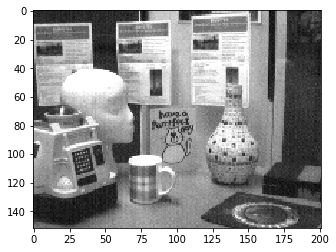

In [202]:
plt.imshow(gif1,cmap="gray")

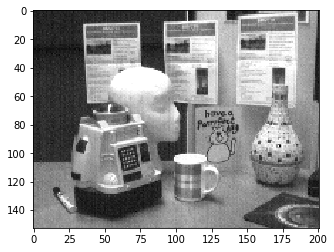

In [203]:
plt.imshow(gif2,cmap="gray")

In [309]:
import cv2
import numpy as np

# img1 = cv2.imread('/home/n/images/desk0.gif')

sift = cv2.xfeatures2d.SIFT_create()
kp1, des1 = sift.detectAndCompute(gif1,None)
kp2, des2 = sift.detectAndCompute(gif2,None)
# kpimg = cv2.drawKeypoints(gray, kp, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)    
# plt.figure(figsize=(18,19),dpi=80)

# plt.imshow(kpimg)

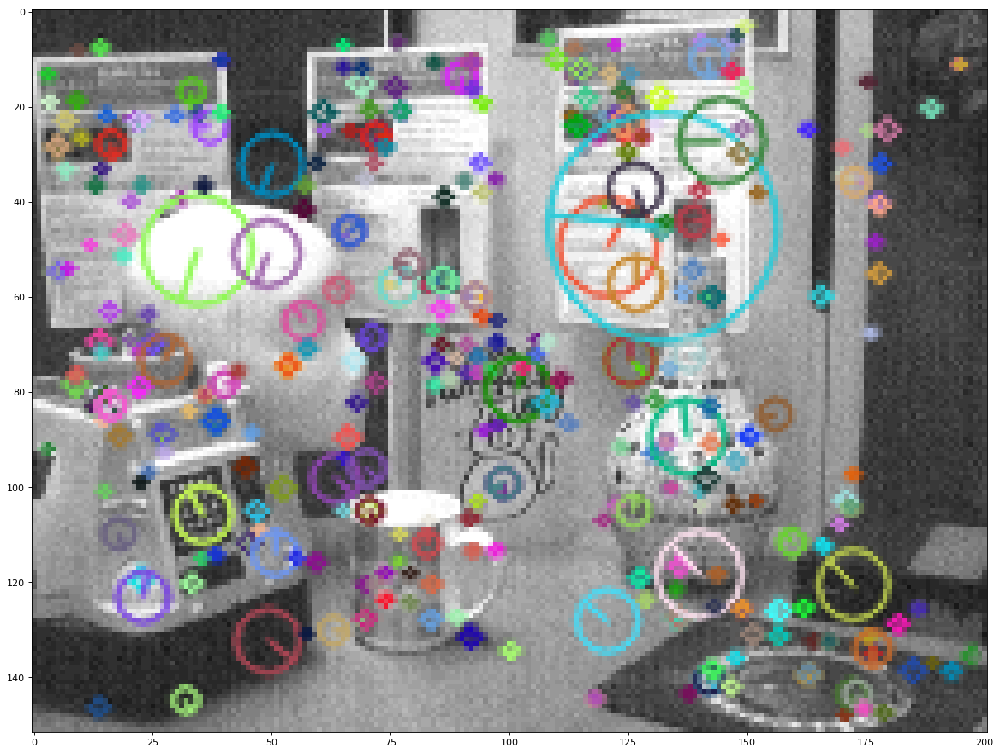

In [310]:
kpimg = cv2.drawKeypoints(g1, kp1, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)  
plt.figure(figsize=(18,19),dpi=80)
plt.imshow(kpimg)

In [182]:
import cv2
import numpy as np

img1 = cv2.imread('/home/n/images/sample-a.jpg')
gray1= cv2.cvtColor(img1,cv2.COLOR_BGR2GRAY)
img2 = cv2.imread('/home/n/images/sample-b.jpg')
gray2 = cv2.cvtColor(img2,cv2.COLOR_BGR2GRAY)

sift = cv2.xfeatures2d.SIFT_create()
kp1, des1 = sift.detectAndCompute(gray1,None)
kp2, des2 = sift.detectAndCompute(gray2,None)

In [205]:
im1cords = [p.pt for p in kp1]
im2cords = [p.pt for p in kp2]

im1cords = np.array(im1cords)
im2cords = np.array(im2cords)

In [207]:


dis = []
loc = []
cords = []
s = []
for v1,c_1 in zip(des1,im1cords):
    for v2,c_2 in zip(des2,im2cords):
        d = np.sqrt(np.sum(np.square(v2-v1)))
        dis.append(d)
        loc.append((c_1,c_2))
    q = np.argmin(dis)
    cords.append(loc[q])
    s.append(dis[q])
    dis = []
    loc = []

In [315]:
s # distance among descriptors
cords # cordinates from above

[(array([ 2.7047863 , 91.98846436]), array([36.5573349 , 89.77702332])),
 (array([ 2.8451581 , 13.27946568]), array([181.83374023,   5.49352121])),
 (array([ 3.34360933, 18.87265587]), array([181.35256958,  12.58555412])),
 (array([ 4.6912961, 54.6282196]), array([39.15010452, 53.51185989])),
 (array([ 4.97008562, 54.53394699]), array([73.93836975, 26.02478027])),
 (array([ 4.99122477, 28.40256691]), array([148.22846985,  23.99036598])),
 (array([ 4.99122477, 28.40256691]), array([148.22846985,  23.99036598])),
 (array([ 6.72908354, 22.86380577]), array([149.80224609,  18.08349419])),
 (array([ 6.74670792, 33.18371964]), array([40.00078583, 32.37545013])),
 (array([ 7.26719236, 54.02418137]), array([40.00078583, 32.37545013])),
 (array([ 8.72875404, 78.41168213]), array([42.65299225, 76.86451721])),
 (array([ 8.72875404, 78.41168213]), array([42.65299225, 76.86451721])),
 (array([ 8.7982378 , 76.33708954]), array([170.5790863 , 122.86055756])),
 (array([ 9.0203104 , 18.66215897]), arra

In [208]:
len(s)

1185

In [209]:
cords = np.array(cords)
s = np.array(s)

In [210]:

index = np.argsort(s)

In [211]:
index

array([ 265, 1013,  951, ...,  740,  488,  618])

In [212]:

cords_sorted = cords[index]

In [844]:

lol = np.ndarray.tolist(cords_sorted)
lol = lol[:20]

In [845]:
len(lol)

20

# RANSAC

In [5]:
import random

In [447]:
qq = random.sample(lol,4)

In [448]:
qq

[[[157.27099609375, 309.1142883300781],
  [193.1799774169922, 279.8538818359375]],
 [[270.2185363769531, 432.68927001953125],
  [296.062744140625, 408.7877197265625]],
 [[535.0570068359375, 583.5823364257812], [549.166748046875, 576.49560546875]],
 [[493.39166259765625, 405.6499938964844],
  [519.5927124023438, 397.6682434082031]]]

In [449]:

[qq[0][0],qq[1][0],qq[2][0],qq[3][0]]

[[157.27099609375, 309.1142883300781],
 [270.2185363769531, 432.68927001953125],
 [535.0570068359375, 583.5823364257812],
 [493.39166259765625, 405.6499938964844]]

In [450]:
p1 = [qq[i][0] for i in range(0,4)]
p2 = [qq[i][1] for i in range(0,4)]

In [451]:
H = gethomography(p1,p2)

In [452]:
Hi = np.linalg.inv(H)

In [453]:
for t1,t2 in zip(p1,p2):
    print(t1,t2)

[157.27099609375, 309.1142883300781] [193.1799774169922, 279.8538818359375]
[270.2185363769531, 432.68927001953125] [296.062744140625, 408.7877197265625]
[535.0570068359375, 583.5823364257812] [549.166748046875, 576.49560546875]
[493.39166259765625, 405.6499938964844] [519.5927124023438, 397.6682434082031]


In [454]:
l = calculteXY(p2,H)
l1 = calculteXY(p1,Hi)

In [469]:
# m.shape
p1

array([[519.60302734, 402.39587402,   1.        ],
       [518.41589355, 167.83648682,   1.        ],
       [442.28289795, 463.22479248,   1.        ],
       [233.66989136, 406.73721313,   1.        ]])

In [456]:
yy =np.insert(p1, 2, 1, axis=1)
yy = yy.reshape((4,3,1))
yy

array([[[157.27099609],
        [309.11428833],
        [  1.        ]],

       [[270.21853638],
        [432.68927002],
        [  1.        ]],

       [[535.05700684],
        [583.58233643],
        [  1.        ]],

       [[493.3916626 ],
        [405.6499939 ],
        [  1.        ]]])

In [457]:
yyy =np.insert(p2, 2, 1, axis=1)
yyy = yyy.reshape((4,3,1))

In [458]:
np.sum(np.sqrt(abs(l**2 - yy**2)))/(np.sum(l+yy)) + np.sum(np.sqrt(abs(l1**2 - yyy**2)))/(np.sum(l1+yyy))

0.4288827024020011

In [459]:
np.sqrt(573)*2

47.8748368143433

In [460]:
np.sqrt(782+48)

28.809720581775867

In [461]:
l.shape

(4, 3, 1)

In [518]:
type(l)
err = []
HM = np.zeros((150,3,3))
i = 0
H_co = [] 
e = 1

In [519]:
E = 0

In [539]:
len(lol)

2

In [895]:
type(l)
err = []
HM = np.zeros((50,3,3))
i = 0
H_co = [] 
e = 1.5
E = 0

while i < 20:
    u = 0
    
    
    qq = random.sample(lol,4)
    p1 = [qq[o][0] for o in range(0,4)]
    p2 = [qq[o][1] for o in range(0,4)]
    yy =np.insert(p1, 2, 1, axis=1)
    yy = yy.reshape((4,3,1))
#     p1 = p1.reshape((4,3,1))
    yyy =np.insert(p2, 2, 1, axis=1)
    yyy = yyy.reshape((4,3,1))
    H = gethomography(p1,p2)
    Hi = np.linalg.inv(H)
    l = calculteXY(p2,H)
    l1 = calculteXY(p1,Hi)
    p1 =np.insert(p1, 2, 1, axis=1)
    p1 = p1.reshape((4,3,1))
    p2 =np.insert(p2, 2, 1, axis=1)
    p2 = p2.reshape((4,3,1))
#     yy =np.insert(p1, 2, 1, axis=1)
#     yy = yy.reshape((4,3,1))
#     p1 = p1.reshape((4,3,1))
#     yyy =np.insert(p2, 2, 1, axis=1)
#     yyy = yyy.reshape((4,3,1))
#     p2 = p2.reshape((4,3,1))
    E = np.sum(np.sqrt(abs(l**2 - yy**2)))/(abs(np.sum(l+yy))) + np.sum(np.sqrt(abs(l1**2 - yyy**2)))/(abs(np.sum(l1+yyy)))
    err.append(E)
    HM[i] = H
    i = i+1
    H_co.append(qq)
    if E < e:
        e = E
        best_H = H
        best_Hi = Hi
        best_p = qq
        print("**")


**
**


In [6]:
def ransac_p(lol):
#     type(l)
    err = [] #storing reconstruction error
    HM = np.zeros((50,3,3)) #stores H, (x,y,1) and corresponding (x,y,1)
    i = 0
    H_co = [] 
    e = 2
    E = 0

    while i < 20:
        u = 0


        qq = random.sample(lol,4) # l is list conatining correspondance
        p1 = [qq[o][0] for o in range(0,4)] # takes cordinates from img 1
        p2 = [qq[o][1] for o in range(0,4)] #takes coordinates from img 2
        yy =np.insert(p1, 2, 1, axis=1)  # insert 1 to correspondance from img1
        yy = yy.reshape((4,3,1))
    #     p1 = p1.reshape((4,3,1))
        yyy =np.insert(p2, 2, 1, axis=1)
        yyy = yyy.reshape((4,3,1))
        H = gethomography(p1,p2) #see 5.1 for this function
        Hi = np.linalg.inv(H)
        l = calculteXY(p2,H) #see above 5.2 for this function
        l1 = calculteXY(p1,Hi)
        p1 =np.insert(p1, 2, 1, axis=1)
        p1 = p1.reshape((4,3,1))
        p2 =np.insert(p2, 2, 1, axis=1)
        p2 = p2.reshape((4,3,1))
    #     yy =np.insert(p1, 2, 1, axis=1)
    #     yy = yy.reshape((4,3,1))
    #     p1 = p1.reshape((4,3,1))
    #     yyy =np.insert(p2, 2, 1, axis=1)
    #     yyy = yyy.reshape((4,3,1))
    #     p2 = p2.reshape((4,3,1))
        E = np.sum(np.sqrt(abs(l**2 - yy**2)))/(abs(np.sum(l+yy))) + np.sum(np.sqrt(abs(l1**2 - yyy**2)))/(abs(np.sum(l1+yyy)))
        err.append(E)
        HM[i] = H
        i = i+1
        H_co.append(qq)
        if E < e:
            e = E
            best_H = H
            best_Hi = Hi
            best_p = qq
            print("**")
        
            
        return best_H,best_Hi
    
    # directly go to ransac_m()

In [847]:
hy = np.array([[ 1.04154737e+00,  5.96828578e-03, -3.62848226e+01],
       [ 2.30620235e-03,  1.00623438e+00,  6.68025498e-01],
       [ 2.76109052e-04, -8.76867439e-05,  9.90314680e-01]])

In [848]:
best_H

array([[ 9.77474961e-01, -6.47787241e-02,  5.54579373e+01],
       [ 5.04882751e-02,  9.92785821e-01, -3.60258828e+01],
       [-3.74540969e-05,  8.24287875e-06,  1.00000000e+00]])

In [849]:
lol2 = np.array(lol)

In [850]:
cc = np.array(best_p)

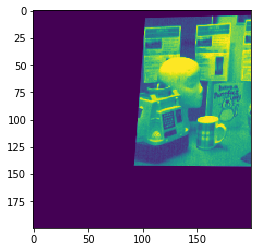

In [851]:
hyi = np.linalg.inv(hy)
next_img_warp = cv2.warpPerspective(gif2,best_Hi, (170, 170))
plt.imshow(best_img_warp)

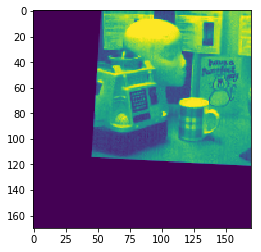

In [852]:
best_img_warp = cv2.warpPerspective(gif1,best_H, (170, 170))
plt.imshow(best_img_warp)

In [853]:
gif1.shape

(152, 201)

In [807]:
o = cv2.warpPerspective(gif1,Mask,(150,200))

NameError: name 'Mask' is not defined

In [808]:
o2 = cv2.warpPerspective(gif2,best_H,(150,200))

In [248]:
o = cv2.warpPerspective(gif1,best_H,(150,200))

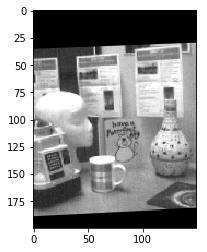

In [249]:
plt.imshow(o2,cmap="gray")

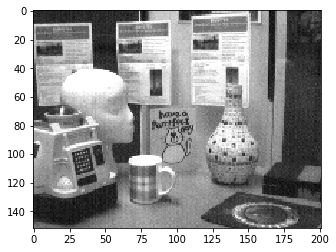

In [252]:
plt.imshow(gif1,cmap="gray")

In [627]:
o2.shape

(200, 150)

In [629]:
o.shape

(200, 150)

In [503]:
Mask

array([[ 9.78086614e-01, -6.22603201e-03,  3.36258575e+01],
       [ 4.12522755e-03,  9.94431874e-01, -7.12640190e-01],
       [-1.63550449e-04,  6.26423842e-05,  1.00000000e+00]])

In [497]:
p12 = np.array(p12)
p11 = np.array(p11)

In [615]:
o2.shape

(201, 153)

In [617]:
o.shape

(200, 150)

# add dim 

In [7]:
def ransac_m(gray1,gray2):
#     gray1= cv2.cvtColor(img1,cv2.COLOR_BGR2GRAY)
#     gray2 = cv2.cvtColor(img2,cv2.COLOR_BGR2GRAY)

    sift = cv2.xfeatures2d.SIFT_create()
    kp1, des1 = sift.detectAndCompute(gray1,None)
    kp2, des2 = sift.detectAndCompute(gray2,None)
    
    im1cords = [p.pt for p in kp1]
    im2cords = [p.pt for p in kp2]

    im1cords = np.array(im1cords)
    im2cords = np.array(im2cords)

    dis = []
    loc = []
    cords = []
    s = []
    for v1,c_1 in zip(des1,im1cords):
        for v2,c_2 in zip(des2,im2cords):
            d = np.sqrt(np.sum(np.square(v2-v1)))
            dis.append(d)
            loc.append((c_1,c_2))
        q = np.argmin(dis)
        cords.append(loc[q])
        s.append(dis[q])
        dis = []
        loc = []
    cords = np.array(cords)
    s = np.array(s)
    index = np.argsort(s)
    cords_sorted = cords[index]
    lol = np.ndarray.tolist(cords_sorted)
    lol = lol[:50]
    H,Hi = ransac_p(lol)
    return H,Hi
    

In [1271]:
H,Hi = ransac_m(gif1,gif2)

**


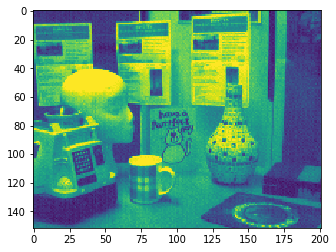

In [1272]:
plt.imshow(gif1)

# array([[ 1.04154737e+00,  5.96828578e-03, -3.62848226e+01],
       [ 2.30620235e-03,  1.00623438e+00,  6.68025498e-01],
       [ 2.76109052e-04, -8.76867439e-05,  9.90314680e-01]])

1



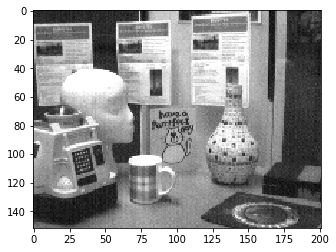

In [1273]:
plt.imshow(gif1,cmap="gray")

# This is where stitching is defined

In [1274]:
enlarged_base_img = np.zeros((200,200), np.uint8)

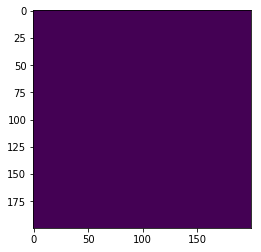

In [1275]:
plt.imshow(enlarged_base_img)

In [1276]:
next_img_warp = cv2.warpPerspective(gif2,Hi, (200, 200))

In [1277]:
best_img_warp = cv2.warpPerspective(gif1,H, (200, 200))

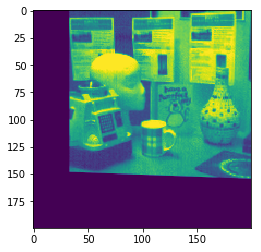

In [1278]:
plt.imshow(best_img_warp)

In [1279]:
(ret,data_map) = cv2.threshold(next_img_warp, 
0, 255, cv2.THRESH_BINARY)
# (ret,data_map) = cv2.threshold(best_img_warp, 
# 0, 255, cv2.THRESH_BINARY)

In [1280]:
data_map.shape

(200, 200)

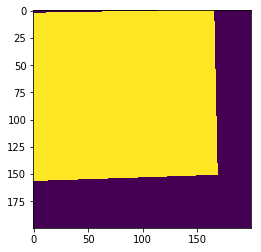

In [1281]:
plt.imshow(data_map)

In [1282]:
enlarged_base_img = cv2.add(enlarged_base_img, best_img_warp,mask=cv2.bitwise_not(data_map))
# enlarged_base_img = cv2.add(enlarged_base_img, next_img_warp,mask=cv2.bitwise_not(data_map.T))

In [1283]:
po = cv2.bitwise_not(data_map)

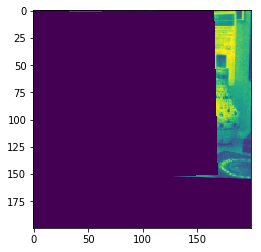

In [1284]:
plt.imshow(enlarged_base_img)

In [1285]:
final_img = cv2.add(enlarged_base_img, next_img_warp, 
                dtype=cv2.CV_8U)


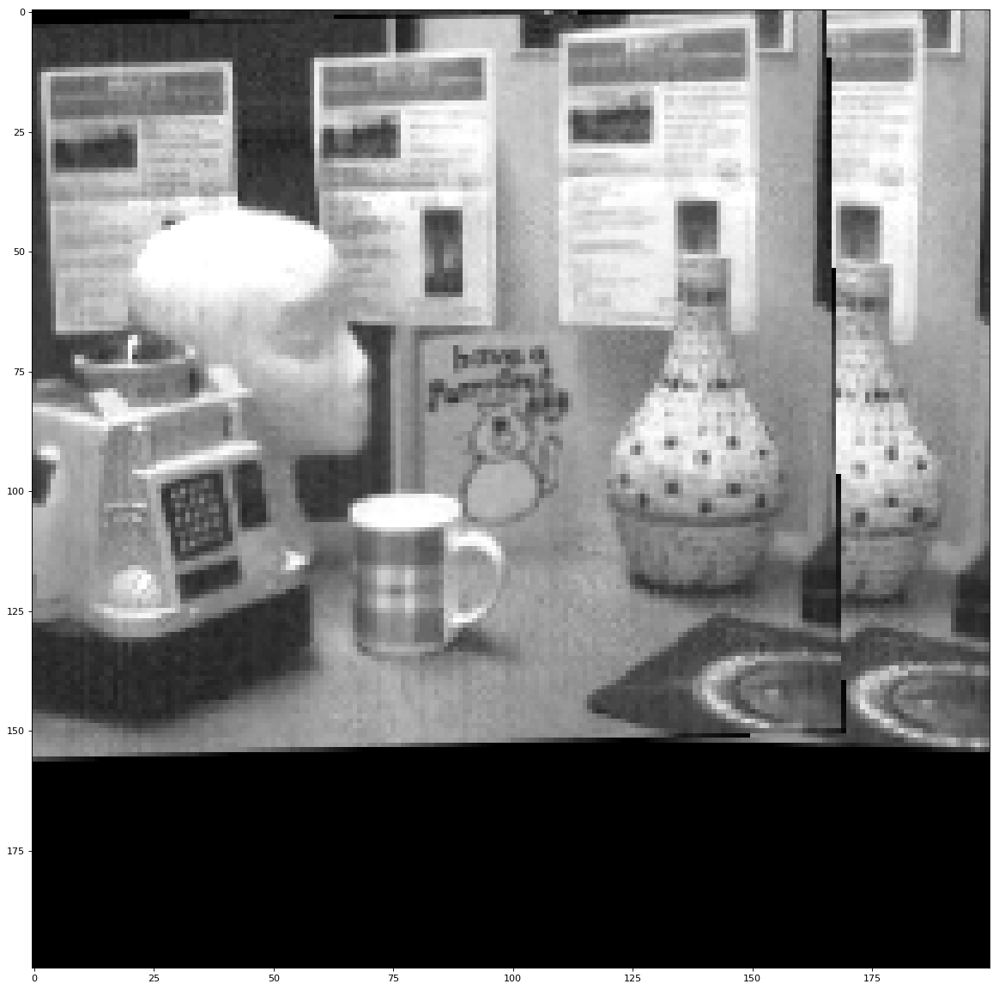

In [1286]:
plt.figure(figsize=(18,19),dpi=80)

plt.imshow(final_img,cmap="gray")

In [8]:

img1 = cv2.imread('/home/n/images/r1.jpg')
gray1= cv2.cvtColor(img1,cv2.COLOR_BGR2GRAY)
img2 = cv2.imread('/home/n/images/r2.jpg')
gray2 = cv2.cvtColor(img2,cv2.COLOR_BGR2GRAY)
img3 = cv2.imread('/home/n/images/r3.jpg')
gray3 = cv2.cvtColor(img3,cv2.COLOR_BGR2GRAY)
sift = cv2.xfeatures2d.SIFT_create()
kp1, des1 = sift.detectAndCompute(gray1,None)
kp2, des2 = sift.detectAndCompute(gray2,None)
kp3, des3 = sift.detectAndCompute(gray3,None)

In [12]:
H12,H12i = ransac_m(gray1,gray2)

**


In [13]:
H13,H13i = ransac_m(gray1,gray3)

**


In [19]:
H23,H23i = ransac_m(gray2,gray3)

**


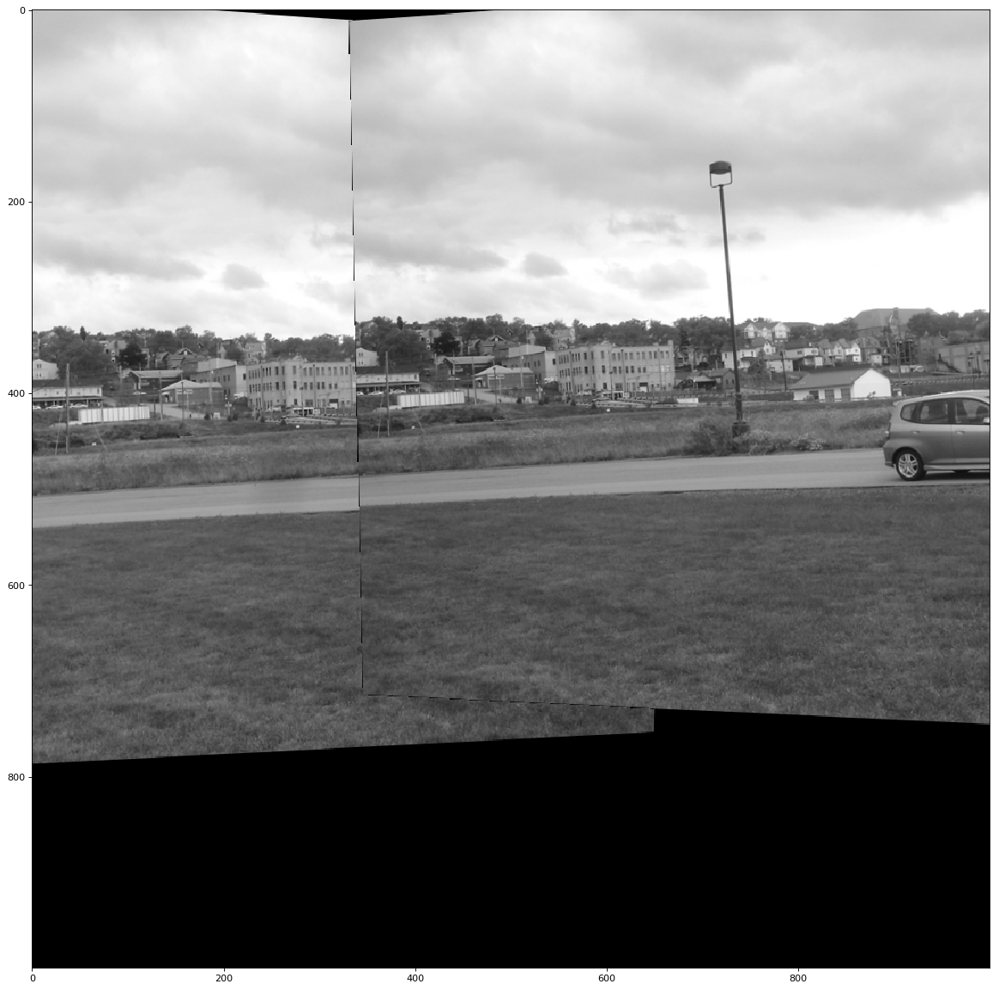

In [15]:
enlarged_base_img = np.zeros((1000,1000), np.uint8)
next_img_warp = cv2.warpPerspective(gray2,H12i, (1000, 1000))
best_img_warp = cv2.warpPerspective(gray1,H12, (1000, 1000))
(ret,data_map) = cv2.threshold(next_img_warp, 
0, 255, cv2.THRESH_BINARY)
enlarged_base_img = cv2.add(enlarged_base_img, best_img_warp,mask=cv2.bitwise_not(data_map))
final_img = cv2.add(enlarged_base_img, next_img_warp, 
                dtype=cv2.CV_8U)

plt.figure(figsize=(18,19),dpi=80)
l = final_img
plt.imshow(final_img,cmap="gray")

In [24]:
enlarged_base_img = np.zeros((2000,2000), np.uint8)
next_img_warp = cv2.warpPerspective(gray3,H23i, (2000, 2000))
best_img_warp = cv2.warpPerspective(l,H23, (2000, 2000))
(ret,data_map) = cv2.threshold(next_img_warp, 
0, 255, cv2.THRESH_BINARY)
enlarged_base_img = cv2.add(enlarged_base_img, best_img_warp,mask=cv2.bitwise_not(data_map))
final_img = cv2.add(enlarged_base_img
                    , next_img_warp, 
                dtype=cv2.CV_8U)


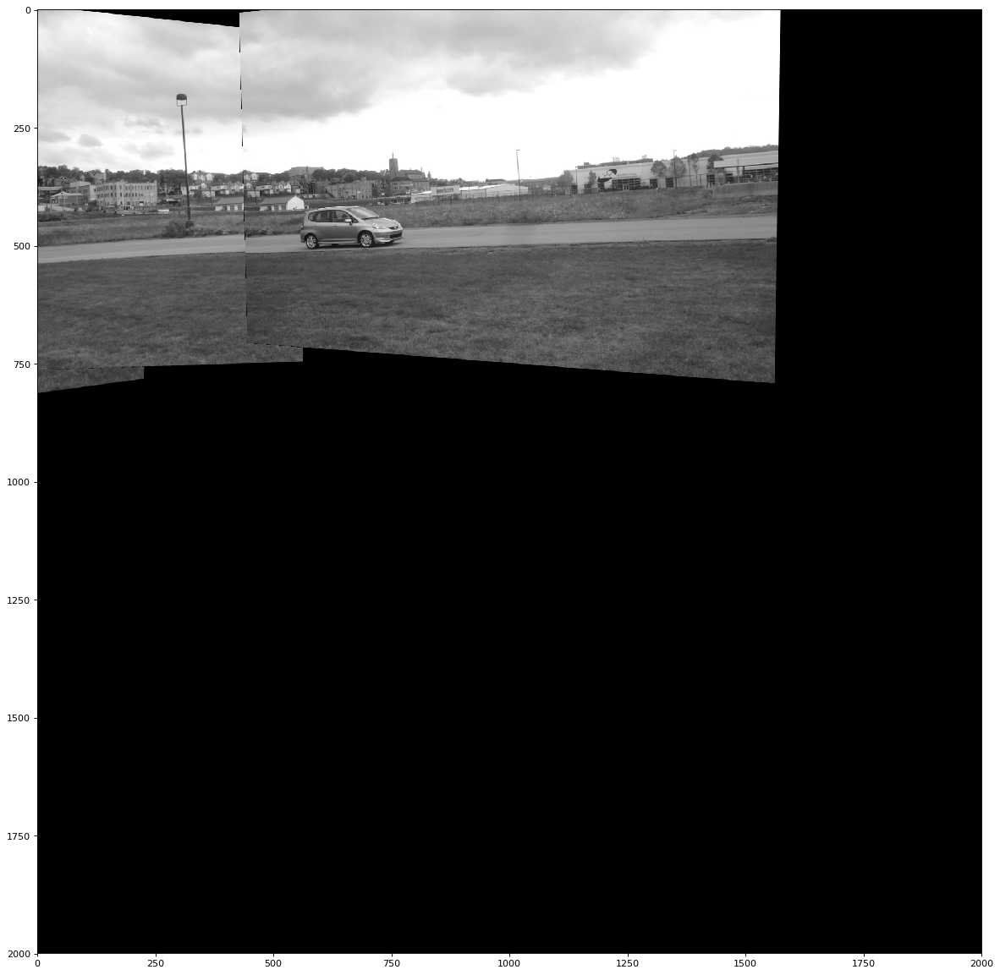

In [25]:
plt.figure(figsize=(18,19),dpi=80)

plt.imshow(final_img,cmap="gray")

In [27]:

img1 = cv2.imread('/home/n/images/m1.jpg')
gray1= cv2.cvtColor(img1,cv2.COLOR_BGR2GRAY)
img2 = cv2.imread('/home/n/images/m2.jpg')
gray2 = cv2.cvtColor(img2,cv2.COLOR_BGR2GRAY)
img3 = cv2.imread('/home/n/images/m3.jpg')
gray3 = cv2.cvtColor(img3,cv2.COLOR_BGR2GRAY)
img4 = cv2.imread('/home/n/images/m4.jpg')
gray4 = cv2.cvtColor(img4,cv2.COLOR_BGR2GRAY)
img5 = cv2.imread('/home/n/images/m5.jpg')
gray5 = cv2.cvtColor(img5,cv2.COLOR_BGR2GRAY)
img6 = cv2.imread('/home/n/images/m6.jpg')
gray6 = cv2.cvtColor(img6,cv2.COLOR_BGR2GRAY)
img7 = cv2.imread('/home/n/images/m7.jpg')
gray7 = cv2.cvtColor(img7,cv2.COLOR_BGR2GRAY)
sift = cv2.xfeatures2d.SIFT_create()
kp1, des1 = sift.detectAndCompute(gray1,None)
kp2, des2 = sift.detectAndCompute(gray2,None)
kp3, des3 = sift.detectAndCompute(gray3,None)
kp4, des4 = sift.detectAndCompute(gray4,None)
kp5, des5 = sift.detectAndCompute(gray5,None)
kp6, des6 = sift.detectAndCompute(gray6,None)
kp7, des7 = sift.detectAndCompute(gray7,None)

In [35]:
H12,H12i = ransac_m(gray1,gray2)


**


In [42]:
H23,H23i = ransac_m(gray2,gray3)


**


In [56]:
H34,H34i = ransac_m(gray3,gray4)


**


In [31]:
H45,H45i = ransac_m(gray4,gray5)


**


In [32]:
H56,H56i = ransac_m(gray5,gray6)


**


In [33]:
H67,H67i = ransac_m(gray6,gray7)

**


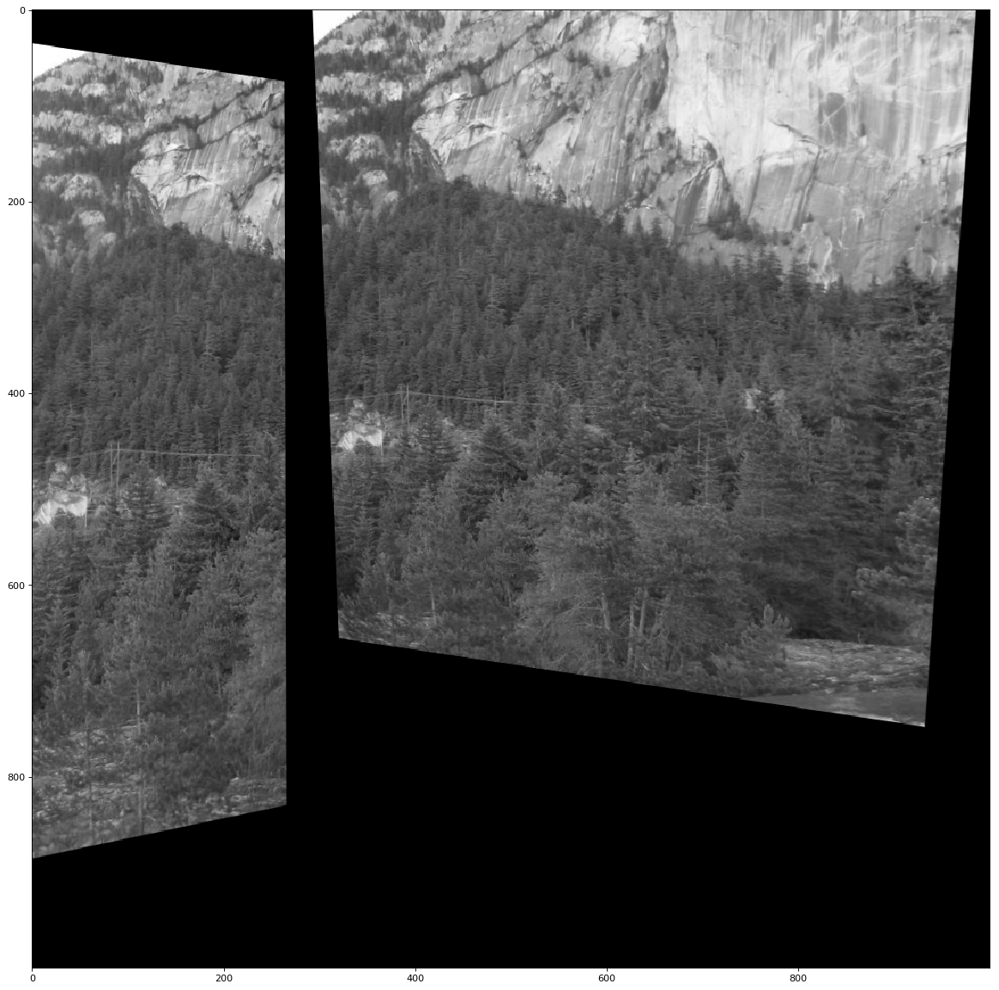

In [44]:
enlarged_base_img = np.zeros((1000,1000), np.uint8)
next_img_warp = cv2.warpPerspective(gray2,H12i, (1000, 1000))
best_img_warp = cv2.warpPerspective(gray1,H12, (1000, 1000))
(ret,data_map) = cv2.threshold(next_img_warp, 
0, 255, cv2.THRESH_BINARY)
enlarged_base_img = cv2.add(enlarged_base_img, best_img_warp,mask=cv2.bitwise_not(data_map))
final_img = cv2.add(enlarged_base_img, next_img_warp, 
                dtype=cv2.CV_8U)

plt.figure(figsize=(18,19),dpi=80)
l12 = final_img
plt.imshow(final_img,cmap="gray")

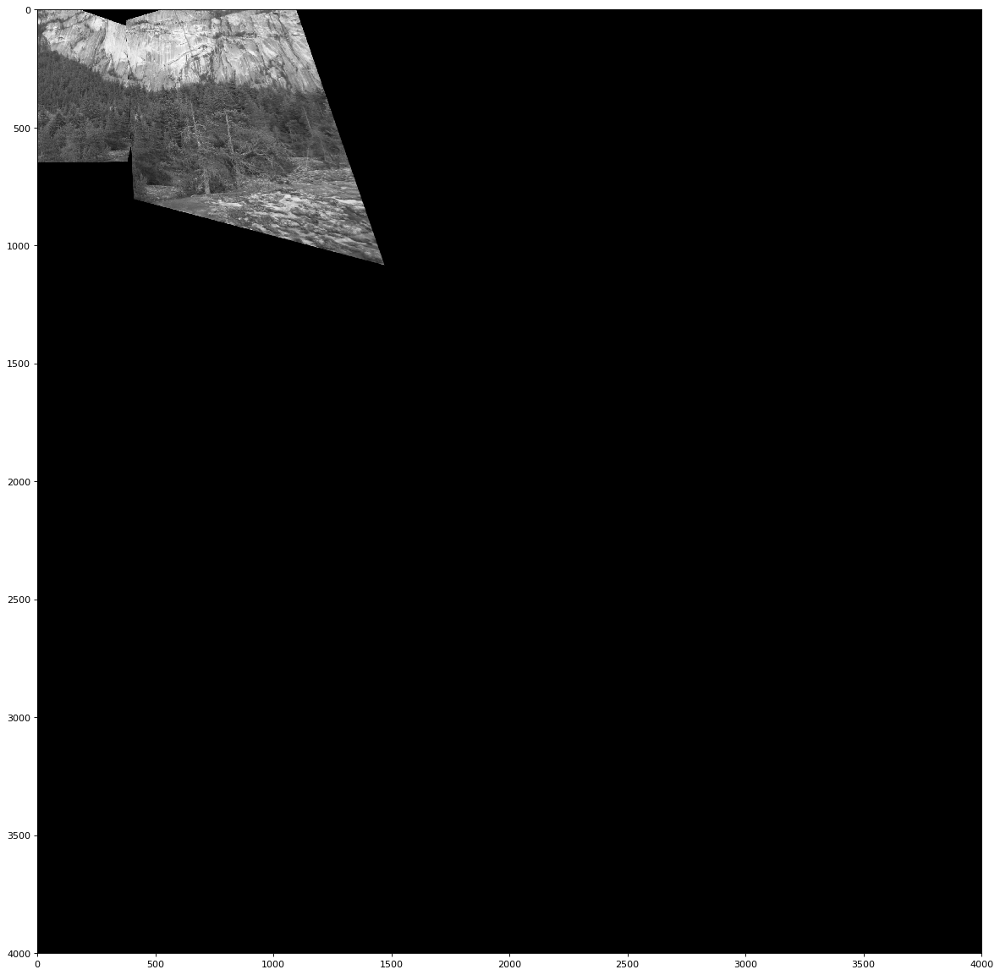

In [48]:
enlarged_base_img = np.zeros((4000,4000), np.uint8)
next_img_warp = cv2.warpPerspective(gray3,H23i, (4000, 4000))
best_img_warp = cv2.warpPerspective(l12,H23, (4000, 4000))
(ret,data_map) = cv2.threshold(next_img_warp, 
0, 255, cv2.THRESH_BINARY)
enlarged_base_img = cv2.add(enlarged_base_img, best_img_warp,mask=cv2.bitwise_not(data_map))
final_img = cv2.add(enlarged_base_img, next_img_warp, 
                dtype=cv2.CV_8U)

plt.figure(figsize=(18,19),dpi=80)
l23 = final_img
plt.imshow(final_img,cmap="gray")

In [67]:
H34,H34i = ransac_m(gray3,gray5)

**


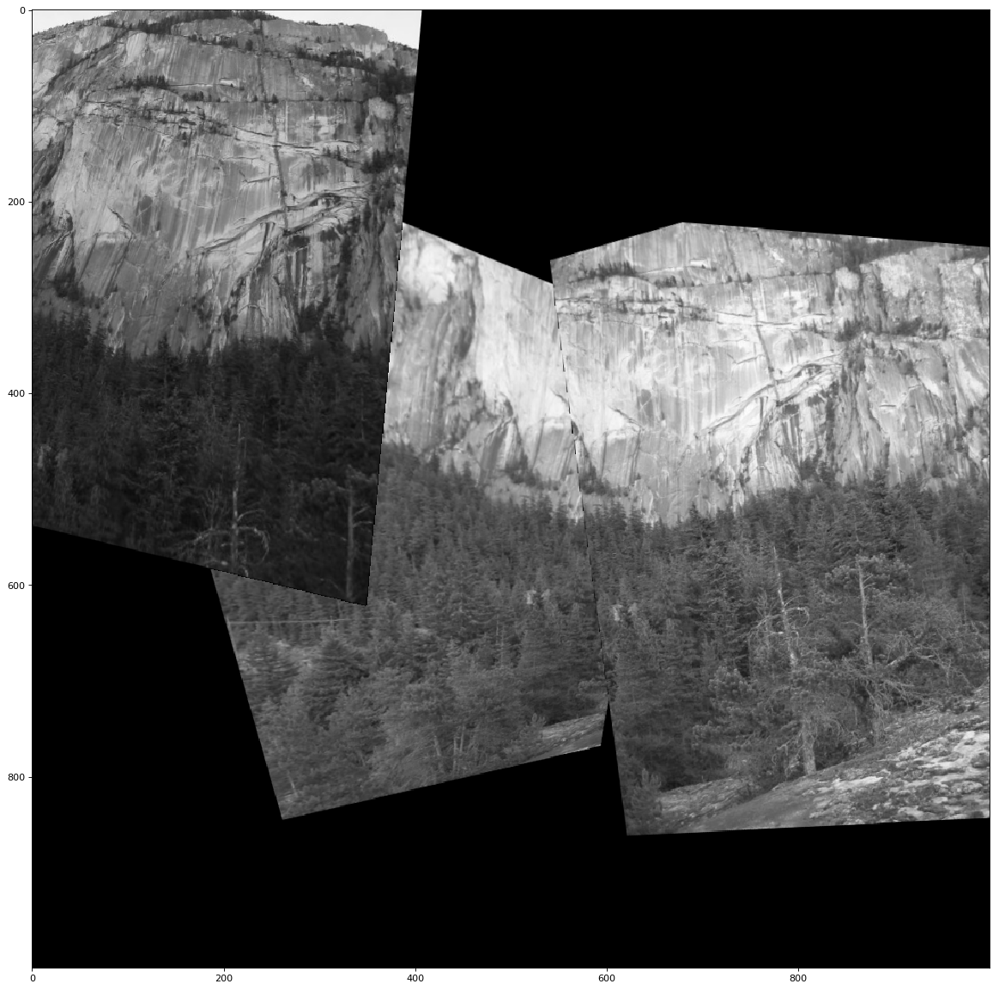

In [89]:
enlarged_base_img = np.zeros((1000,1000), np.uint8)
next_img_warp = cv2.warpPerspective(gray5,H34i, (1000, 1000))
best_img_warp = cv2.warpPerspective(l23,H34, (1000, 1000))
(ret,data_map) = cv2.threshold(next_img_warp, 
0, 255, cv2.THRESH_BINARY)
enlarged_base_img = cv2.add(enlarged_base_img, best_img_warp,mask=cv2.bitwise_not(data_map))
final_img = cv2.add(enlarged_base_img, next_img_warp, 
                dtype=cv2.CV_8U)

plt.figure(figsize=(18,19),dpi=80)
l35 = final_img
plt.imshow(final_img,cmap="gray")

In [75]:
H57,H57i = ransac_m(gray5,gray7)

**


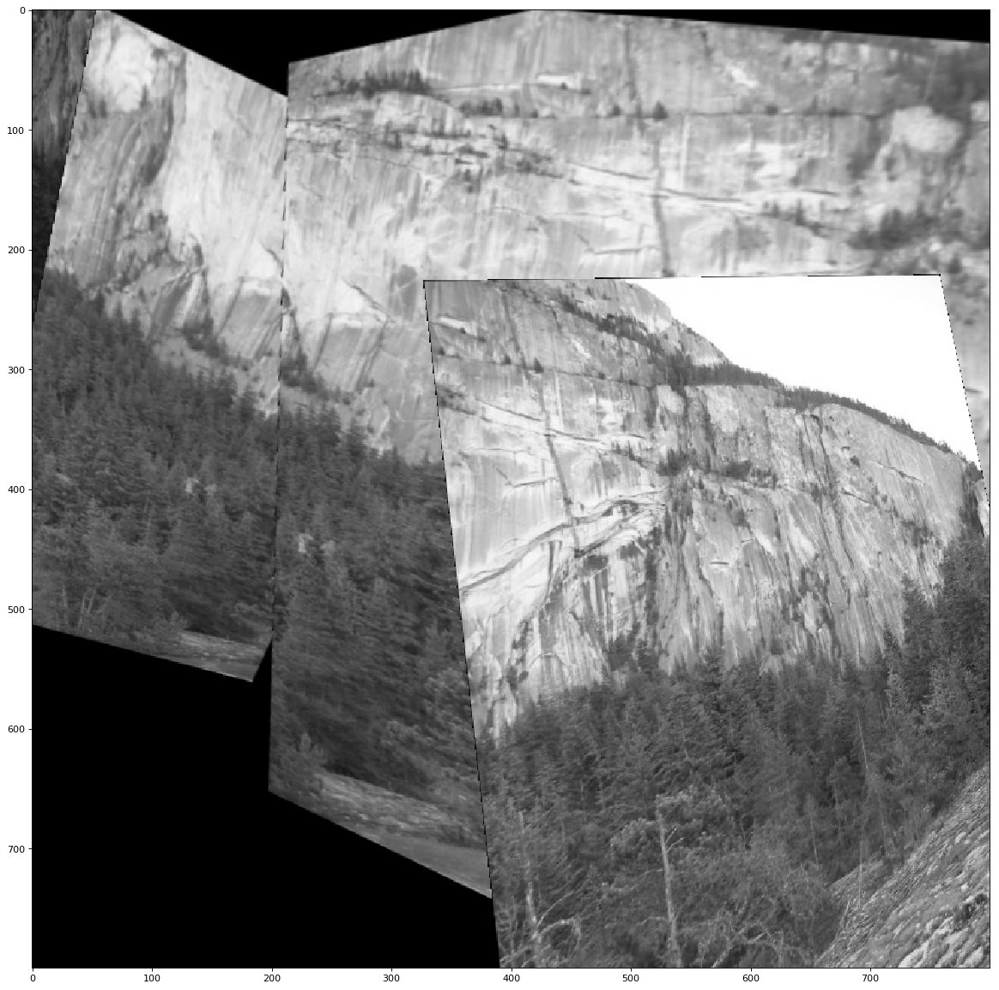

In [88]:
enlarged_base_img = np.zeros((800,800), np.uint8)
next_img_warp = cv2.warpPerspective(gray7,H57i, (800, 800))
best_img_warp = cv2.warpPerspective(l35,H57, (800, 800))
(ret,data_map) = cv2.threshold(next_img_warp, 
0, 255, cv2.THRESH_BINARY)
enlarged_base_img = cv2.add(enlarged_base_img, best_img_warp,mask=cv2.bitwise_not(data_map))
final_img = cv2.add(enlarged_base_img, next_img_warp, 
                dtype=cv2.CV_8U)

plt.figure(figsize=(18,19),dpi=80)
l57 = final_img
plt.imshow(final_img,cmap="gray")

In [81]:
import cv2 
op = []

def clickEvent(event,x,y,flags,param):
    global op 

    if event == cv2.EVENT_LBUTTONDBLCLK:
        print(x,y)

        
        op.append((x,y))
    

WINDOW_NAME = "win"

image = l57
cv2.namedWindow(WINDOW_NAME, cv2.WINDOW_AUTOSIZE)
# initialtime = time.time()

cv2.startWindowThread()
cv2.imshow(WINDOW_NAME, image)
# cv.waitKey(1000)
cv2.setMouseCallback("win", clickEvent)
# cv.waitKey(1)
# cv.destroyAllWindows()
c = cv2.waitKey(0)
if 'q' == chr(c & 255):
    cv2.destroyAllWindows()


10 520
1007 995
1439 87
174 12


In [82]:
op

[(10, 520), (1007, 995), (1439, 87), (174, 12)]

/home/n/anaconda3/envs/opencv/lib/python3.6/site-packages/matplotlib/axes/_base.py:3285: UserWarning: Attempting to set identical bottom==top results
in singular transformations; automatically expanding.
bottom=-0.5, top=-0.5
  'bottom=%s, top=%s') % (bottom, top))


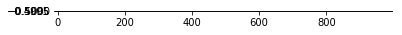

In [84]:
pp,c = convert_rectangle(l57,op)

array([[  10,  520],
       [1007,  520],
       [1007,   87],
       [  10,   87]])

In [987]:
l.shape

(1000, 1000)

# https://dtcenter.org/met/users/docs/write_ups/circle_fit.pdf

In [ ]:
def fitCircle(points):
    xpoints_lst=points[:,0]
    ypoints_lst=points[:,1]
    xpoints_lst = np.array(xpoints_lst,dtype=float)
    ypoints_lst = np.array(ypoints_lst,dtype=float)
    x_mean = np.mean(xpoints_lst)
    y_mean = np.mean(ypoints_lst)
    xpoints_lst = xpoints_lst-x_mean
    ypoints_lst = ypoints_lst-y_mean
    suu = np.sum(np.square(xpoints_lst))
    svv = np.sum(np.square(ypoints_lst))
    suv = np.sum(np.multiply(xpoints_lst,ypoints_lst))
    suuu = np.sum(np.power(xpoints_lst,3))
    svvv = np.sum(np.power(ypoints_lst,3))
    suvv = np.sum(np.multiply(xpoints_lst,np.square(ypoints_lst)))
    svuu = np.sum(np.multiply(ypoints_lst,np.square(xpoints_lst)))
    a = np.array([[suu,suv],[suv,svv]])
    b = np.array([(suuu+suvv)/2,(svvv+svuu)/2])
    uc,vc = np.linalg.solve(a, b)
    xc = uc+x_mean
    yc = vc+y_mean
    rad = np.sqrt((uc**2)+(vc**2)+((suu+svv)/2))
    return xc,yc,rad
        


def fitCircleRANSAC(points,iterations,thr,inlierRatio):
    xpoints_lst=points[:,0]
    ypoints_lst=points[:,1]
    xpoints_lst = np.array(xpoints_lst,dtype=float)
    ypoints_lst = np.array(ypoints_lst,dtype=float)
    ll = len(xpoints_lst)
    max_points = int(inlierRatio*len(xpoints_lst))
    inliers =np.zeros(len(xpoints_lst),dtype=bool)
    it=0
    rand_lst=[]
    blnrand = False
    bln_found = False
    for it in range(iterations):
        inlier_counter =0
        counter=0
        num = np.random.randint(2*ll)
        while not blnrand:
            if num not in rand_lst:
                rand_lst.append(num)
                blnrand = True
            else :
                num = np.random.randint(2*ll)
        np.random.seed(num)
        xpoints_rand = np.random.choice(xpoints_lst,2,replace=False)
        xpoints_rand = np.array(xpoints_rand,dtype=float)
        np.random.seed(num)
        ypoints_rand = np.random.choice(ypoints_lst,4,replace=False)
        ypoints_rand = np.array(ypoints_rand,dtype=float)
        stack_list = np.vstack(zip(xpoints_rand,ypoints_rand))
        xc,yc,rad=fitCircle(stack_list)
        inlier_list =[]
        inlier_xlist =[]
        inlier_ylist =[]
        outlier_list=[]
        for x,y in zip(xpoints_lst,ypoints_lst):
            counter+=1
            if (x not in xpoints_rand) and (y not in ypoints_rand):
                dist = np.sqrt(np.square(x-xc)+np.square(y-yc))-rad
                if dist<0:
                    inlier_xlist.append(x)
                    inlier_ylist.append(y)
                    inlier_counter+=1
                    inliers[counter]=True
                elif dist<thr:
                    inlier_xlist.append(x)
                    inlier_ylist.append(y)
                    inlier_counter+=1
                    inliers[counter]=True
            if(inlier_counter>=max_points):
                bln_found = True
                break
        if(bln_found):
            break
    inlier_xlist = np.array(inlier_xlist,dtype=float)
    inlier_ylist = np.array(inlier_ylist,dtype=float)
    stack_lst = np.vstack(zip(inlier_xlist,inlier_ylist))
    xc,yc,rad = fitCircle(stack_lst)
    return xc,yc,rad,inlier_xlist,inlier_ylist

In [1096]:
import pdb

In [1137]:
def findleastsquare(df):
#     pdb.set_trace()
    x = df['x']
    x = np.array(x)
    y = df['y']
    y = np.array(y)
    ui = x - np.mean(x)
    vi = y - np.mean(y)
    su = np.sum(ui)
    sv = np.mean(vi)
    suu = np.sum(np.square(ui))
    svv = np.sum(np.square(vi))
    suv = np.sum(np.multiply(ui,vi))
    suuu = np.sum(np.power(ui,3))
    svvv = np.sum(np.power(vi,3))
    suvv = np.sum(np.multiply(ui,np.square(vi)))
    svuu = np.sum(np.multiply(vi,np.square(ui)))
    Q = np.array([[suu,suv],[suv,svv]])
    W = np.array([(suuu+suvv)/2,(svvv+svuu)/2])
    
    uc,vc = np.linalg.lstsq(Q,W)[0]
    
    xc = uc+np.mean(x)
    yc = vc+np.mean(y)
    alpha = np.sqrt((uc**2)+(vc**2)+((suu+svv)/2))
    return xc,yc,alpha
    
    
## https://dtcenter.org/met/users/docs/write_ups/circle_fit.pdf    

In [1266]:

def fitCircleRANSAC(path,iterations,thr,inlierRatio):
    df = pd.read_csv(path, delim_whitespace=True, engine = 'python', names = range(2))
    df.columns = ['x','y']
    x = df['x']
    y = df['y']
    x = np.array(x)
    y = np.array(y)
    n = len(x)
    xo = np.ndarray.tolist(x)
    yo = np.ndarray.tolist(y)
    max_points = int(inlierRatio*n)
   


    for i in range(iterations):
        inlier_counter =0
        xpoints_rand = np.random.choice(xo,2,replace=False)
        xpoints_rand = np.array(xpoints_rand)

        ypoints_rand = np.random.choice(yo,2,replace=False)
        ypoints_rand = np.array(ypoints_rand,dtype=float)
        dff = pd.DataFrame(ypoints_rand)
        dff['y'] = ypoints_rand
        dff.columns = ['x','y']
        xc,yc,alpha=findleastsquare(dff)
 
        inlier_xl =[]
        inlier_yl =[]

        
        for x1,y1 in zip(x,y):
            dist = np.sqrt(np.square(x1-xc)+np.square(y1-yc))-alpha
            if dist<thr:
                inlier_xl.append(x1)
                inlier_yl.append(y1)
                inlier_counter = inlier_counter + 1
            if(inlier_counter>=max_points):
                bln_found = True
                break

    d = pd.DataFrame(inlier_xl)
    d['y'] = inlier_yl
    d.columns = ['x','y']
    xc,yc,alpha = findleastsquare(d)
    return xc,yc,alpha

In [1267]:
xc,yc,rad = fitCircleRANSAC('/home/n/Downloads/circleData.txt',10,1,0.9)


/home/n/anaconda3/envs/opencv/lib/python3.6/site-packages/ipykernel_launcher.py:21: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.


In [1268]:
import matplotlib

-0.05895917364980012 0.01288252692694203 3.2577228560978435


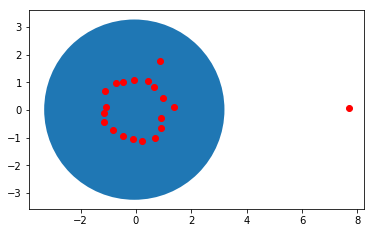

In [1269]:


x = np.array(df['x'],dtype=float)
y= np.array(df['y'],dtype=float)
print(xc,yc,rad)
figure = plt.figure(figsize=(50,50),dpi=50)
fig.set_size_inches(18.5, 10.5)
fig, ax = plt.subplots()
circle = plt.Circle((xc,yc),rad)
ax=plt.gca()
ax.plot(x,y,'ro')
ax.add_patch(circle)
plt.axis('scaled')
plt.show()



In [1231]:
matplotlib.patches.Circle((xc,yc),rad)
plt.show()

In [1091]:


xc,yc,rad = fitCircle(lst_points)
xpoints_lst1 = np.array(xpoints_lst,dtype=float)
ypoints_lst1 = np.array(ypoints_lst,dtype=float)
print(xc,yc,rad)
figure = plt.figure(figsize=(25,16))
fig, ax = plt.subplots()
circle = plt.Circle((xc,yc),rad)
ax=plt.gca()
ax.plot(xpoints_lst1,ypoints_lst1,'ro')
ax.add_patch(circle)
plt.axis('scaled')
plt.show()




NameError: name 'fitCircle' is not defined

In [1172]:
import pandas as pd
df = pd.read_csv('/home/n/Downloads/circleData.txt', delim_whitespace=True, engine = 'python', names = range(2))


In [1173]:
df.columns = ['x','y']

In [1135]:
df.columns = ['x','y']
x,y,a = findleastsquare(df)

> <ipython-input-1133-229bbeb62fcc>(3)findleastsquare()
-> x = df['x']
(Pdb) c


/home/n/anaconda3/envs/opencv/lib/python3.6/site-packages/ipykernel_launcher.py:3: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  This is separate from the ipykernel package so we can avoid doing imports until


0     0.092844
1     0.431485
2     1.781346
3     0.819277
4     1.048728
5     1.093308
6     1.024634
7     0.984222
8     0.687701
9     0.101891
10   -0.097249
11   -0.428404
12   -0.720513
13   -0.947475
14   -1.056804
15   -1.115056
16   -1.002344
17   -0.651265
18   -0.290134
19    0.073357
Name: y, dtype: float64

[ 1.3757799   0.98338493  0.88491441  0.65579693  0.42150232 -0.07082461
 -0.46271796 -0.70319597 -1.1252594  -1.0686745  -1.1423709  -1.1657926
 -0.82084415 -0.47911539 -0.10298021  0.20350852  0.68276469  0.89465962
  0.91000885  7.6829874 ] [ 0.09284356  0.43148458  1.7813465   0.81927659  1.0487285   1.0933078
  1.0246341   0.98422226  0.68770121  0.1018913  -0.09724891 -0.42840393
 -0.72051271 -0.94747509 -1.0568039  -1.115056   -1.0023435  -0.65126475
 -0.29013432  0.07335735] 6.991793742183139


ValueError: setting an array element with a sequence.

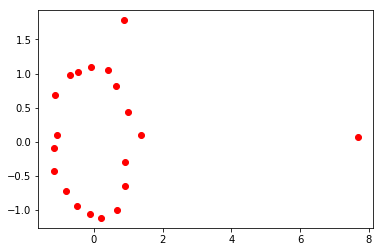

In [1217]:

print(x,y,a)
figure = plt.figure(figsize=(25,16))
fig, ax = plt.subplots()
circle = plt.Circle((x,y),a)
ax=plt.gca()
ax.plot(df['x'],df['y'],'ro')
ax.add_patch(circle)
plt.axis('scaled')
plt.show()




0.66928081 -0.18455134499999992 0.8723567703204247


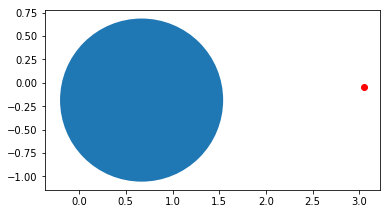

In [1158]:


# xc,yc,rad = fitCircleRANSAC('/home/n/Downloads/circleData.txt',50,1,0.9)
xpoints_lst1 = np.array(x,dtype=float)
ypoints_lst1 = np.array(y,dtype=float)
print(xc,yc,rad)
figure = plt.figure(figsize=(25,16))
fig, ax = plt.subplots()
circle = plt.Circle((xc,yc),rad)
ax=plt.gca()
ax.plot(xpoints_lst1,ypoints_lst1,'ro')
ax.add_patch(circle)
plt.axis('scaled')
plt.show()



In [1117]:
xc,yc,rad = fitCircleRANSAC('/home/n/Downloads/circleData.txt',50,1,0.9)


> <ipython-input-1105-f1e3ac3fee19>(3)findleastsquare()
-> x = df['x']
(Pdb) c


LinAlgError: Singular matrix

In [1072]:
import pandas as pd

In [1069]:
a = np.arange(5,10)

In [1070]:
b = np.arange(20,25)

In [1073]:
d = pd.DataFrame(a)

In [1075]:
d['y'] = b

In [1076]:
d.columns = ['x','y']

In [1077]:
d

,x,y
0,5,20
1,6,21
2,7,22
3,8,23
4,9,24


In [687]:
import imutils

In [688]:
 
class Stitcher:
	def __init__(self):
		# determine if we are using OpenCV v3.X
		self.isv3 = imutils.is_cv3()

In [ ]:
foreground = o
background = o2
alpha = cv2.imread("puppets_alpha.png")
 
# Convert uint8 to float
foreground = foreground.astype(float)
background = background.astype(float)
 
# Normalize the alpha mask to keep intensity between 0 and 1
alpha = alpha.astype(float)/255
 
# Multiply the foreground with the alpha matte
foreground = cv2.multiply(alpha, foreground)
 
# Multiply the background with ( 1 - alpha )
background = cv2.multiply(1.0 - alpha, background)
 
# Add the masked foreground and background.
outImage = cv2.add(foreground, background)
 
# Display image
cv2.imshow("outImg", outImage/255)
cv2.waitKey(0)

In [692]:
from PIL import Image

In [693]:
zzzzz = Image.blend(o,o2,0.2)

AttributeError: 'numpy.ndarray' object has no attribute 'load'

# 42

In [164]:
def get_histogram_features(Image,k,bins,l):
    lol_b = I1[:,:,2]
    lol_g = I1[:,:,1]
    lol_r = I1[:,:,0]
    k = k
    bins = bins
    n = 120
    features_a= []
    filtered_ = hariss_corner(I1,3,2,2,0.001,5,"red")


    for i in (filtered_[:120]):


        V_b = lol_b[(i[0]-k):(i[0]+k+1),(i[1]-k):(i[1]+k+1)]
        V_g = lol_g[(i[0]-k):(i[0]+k+1),(i[1]-k):(i[1]+k+1)]
        V_r = lol_r[(i[0]-k):(i[0]+k+1),(i[1]-k):(i[1]+k+1)]

        hist_b,bins = np.histogram(V_b.flatten(),bins)
        hist_g,_ = np.histogram(V_g.flatten(),bins)
        hist_r,_ = np.histogram(V_r.flatten(),bins)
        coners = np.hstack([hist_b,hist_g,hist_r])

#         print(i)


        norm = np.linalg.norm(con)
        coners = coners/norm
        features_a.append(coners)

    features_a = np.array(features_a) 
    return features_a,filtered_






In [22]:
b = I1[:,:,2]
g = I1[:,:,1]
r = I1[:,:,0]

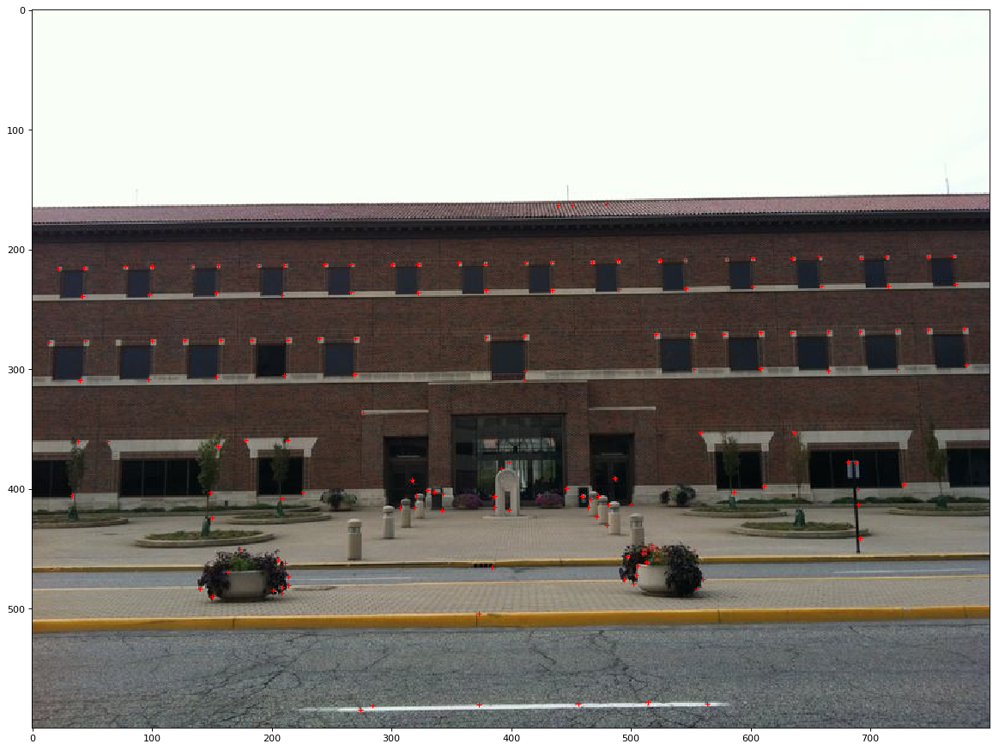

In [81]:

lol_b = I1[:,:,2]
lol_g = I1[:,:,1]
lol_r = I1[:,:,0]
k = 3

bins = 9
n = 120
features_a= []
filtered_ = hariss_corner(I1,3,2,2,0.001,5,"red")


for i in (filtered_[:120]):


    V_b = lol_b[(i[0]-k):(i[0]+k+1),(i[1]-k):(i[1]+k+1)]
    V_g = lol_g[(i[0]-k):(i[0]+k+1),(i[1]-k):(i[1]+k+1)]
    V_r = lol_r[(i[0]-k):(i[0]+k+1),(i[1]-k):(i[1]+k+1)]

    hist_b,bins = np.histogram(V_b.flatten(),bins)
    hist_g,_ = np.histogram(V_g.flatten(),bins)
    hist_r,_ = np.histogram(V_r.flatten(),bins)
    coners = np.hstack([hist_b,hist_g,hist_r])

#         print(i)


    norm = np.linalg.norm(coners)
    coners = coners/norm
    features_a.append(coners)

features_a = np.array(features_a) 
#     return features_a,filtered_






In [82]:
fa = features_a
fca = filtered_

/home/n/anaconda3/envs/opencv/lib/python3.6/site-packages/ipykernel_launcher.py:30: RuntimeWarning: invalid value encountered in true_divide


(27,)


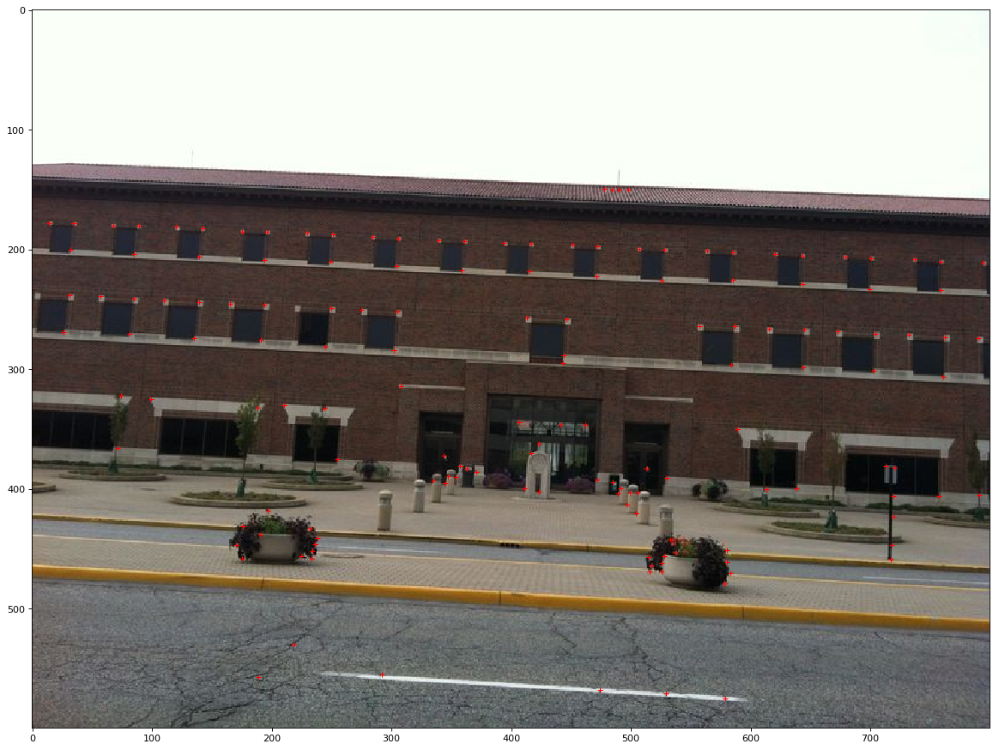

In [83]:

lol_b = I2[:,:,2]
lol_g = I2[:,:,1]
lol_r = I2[:,:,0]
k = 15

bins = 9
n = 120
features_b= []
filtered_a = hariss_corner(I2,3,2,2,0.001,5,"red")


for i in (filtered_a[:120]):


    V_b = lol_b[(i[0]-k):(i[0]+k+1),(i[1]-k):(i[1]+k+1)]
    V_g = lol_g[(i[0]-k):(i[0]+k+1),(i[1]-k):(i[1]+k+1)]
    V_r = lol_r[(i[0]-k):(i[0]+k+1),(i[1]-k):(i[1]+k+1)]

    hist_b,bins = np.histogram(V_b.flatten(),bins)
    hist_g,_ = np.histogram(V_g.flatten(),bins)
    hist_r,_ = np.histogram(V_r.flatten(),bins)
    coners = np.hstack([hist_b,hist_g,hist_r])


#         print(i)


    norm = np.linalg.norm(coners)
    coners = coners/norm
    features_b.append(coners)

features_b = np.array(features_b) 
print(coners.shape)
#     return features_a,filtered_






In [84]:
fb = features_b
fcb = filtered_a

In [85]:
fb.shape

(120, 27)

In [80]:

from sklearn import preprocessing

img = cv2.imread('/home/n/images/sample-a.jpg')
I1 = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

img = cv2.imread('/home/n/images/sample-b.jpg')
I2 = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)


In [89]:
fcb

[(442, 533),
 (403, 499),
 (438, 190),
 (150, 498),
 (431, 176),
 (150, 490),
 (150, 484),
 (555, 292),
 (453, 537),
 (462, 526),
 (392, 472),
 (362, 423),
 (530, 218),
 (332, 188),
 (178, 14),
 (390, 354),
 (274, 135),
 (418, 197),
 (447, 170),
 (149, 478),
 (433, 232),
 (571, 529),
 (406, 757),
 (322, 74),
 (457, 515),
 (185, 175),
 (575, 579),
 (386, 371),
 (366, 71),
 (405, 791),
 (441, 238),
 (180, 68),
 (202, 585),
 (346, 462),
 (267, 645),
 (452, 234),
 (208, 737),
 (403, 506),
 (568, 474),
 (206, 679),
 (557, 189),
 (451, 580),
 (180, 89),
 (391, 530),
 (182, 142),
 (346, 441),
 (325, 99),
 (196, 451),
 (420, 504),
 (400, 613),
 (333, 244),
 (413, 497),
 (207, 701),
 (479, 578),
 (464, 517),
 (242, 110),
 (273, 762),
 (181, 120),
 (284, 302),
 (350, 589),
 (191, 306),
 (178, 35),
 (268, 673),
 (399, 411),
 (375, 255),
 (269, 26),
 (194, 394),
 (275, 191),
 (344, 407),
 (241, 85),
 (461, 580),
 (186, 230),
 (210, 759),
 (306, 761),
 (393, 335),
 (372, 344),
 (246, 194),
 (204, 6

In [86]:
dis = []
loc = []
cords = []
s = []
for v1,c_1 in zip(fa,fca):
    for v2,c_2 in zip(fb,fcb):
        d = np.sqrt(np.sum(np.square(v2-v1)))
        dis.append(d)
        loc.append((c_1,c_2))
    q = np.argmin(dis)
    cords.append(loc[q])
    s.append(dis[q])
    dis = []
    loc = []

In [91]:
a,b = comapred_features(fa,fca,fb,fcb)

In [97]:
required = get_matches(b,a,50)

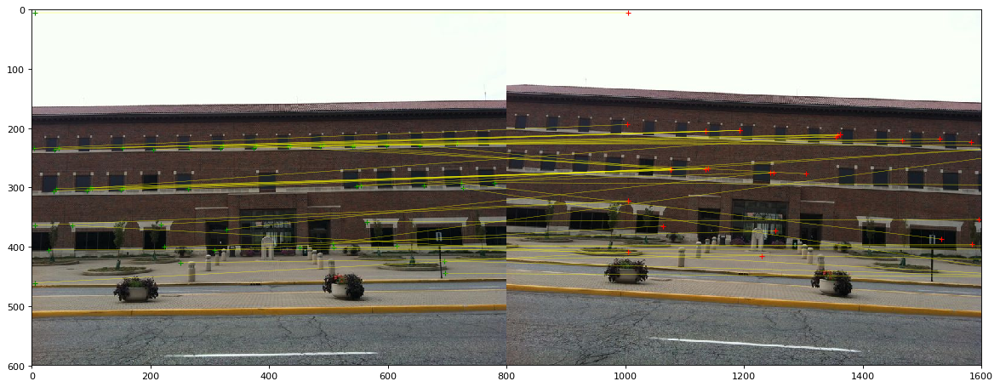

In [100]:
numpy_horizontal = np.hstack((I1, I2))
plt.figure(figsize=(18,19),dpi=80)
plt.plot([p[0][1] for p in required[:,[0]]],[p[0][0] for p in required[:,[0]]],'+',color="green")
plt.plot([p[0][1] for p in required[:,[1]]],[p[0][0] for p in required[:,[1]]],'+',color="red")
plt.plot([[p[0] for p in required[:,[0],[1]]],[p[0] for p in required[:,[1],[1]]]],[[p[0] for p in required[:,[0],[0]]],[p[0] for p in required[:,[1],[0]]]],color="yellow",linewidth=0.3)


plt.imshow(numpy_horizontal)

In [175]:
d = []
sort2 = []
index2 = []

corn_b = []
for i in range(120):
    for k in range(120):
        s =(0.5)*np.sum(np.divide(np.square(np.subtract(V_a[i,:],V_b[k,:])),np.add(V_a[i,:],V_b[k,:]+0.1)))
        d.append(s)
    _ = np.min(d)
    sort2.append(_)
    index2 = d.index(_)
    d = []

    corn_b.append(corner_b[index2])
sortcor1 = []
sortcor2 = []
sort1 = sorted(sort2)




for k in range(120):
    sortcor1.append(corner_a[sort2.index(sort1[k])])
    sortcor2.append(corn_b[sort2.index(sort1[k])])
IMG = np.hstack((I1,I2))
plt.figure(figsize=(18,19),dpi=80)    
sortcor2 = sortcor2[1]+800
for i in range(120):
plt.plot(sortcor1[i][1],sortcor1[i][0],color="red")
plt.plot(sortcor2[i][1],sortcor2[i][0],color="red")
    
plt.plot([p[1] for p in sortcor1],[p[0] for p in sortcor1],'*')
plt.plot([p[1] for p in sortcor2],[p[0] for p in sortcor2],'*') 



plt.plot([[p[1] for p in sortcor1],[p[1] for p in sortcor2]],[[p[0] for p in sortcor1],[p[0] for p in sortcor2]],color="yellow",linewidth=0.3)


plt.imshow(IMG) 

    

IndentationError: expected an indented block (<ipython-input-175-f37a13964f50>, line 31)

In [111]:
len(V_a)

50

In [ ]:
for k in range(10):
    #print('index',min1.index(sort[k]))
    cor11.append(corner1[min2.index(sort1[k])])
    cor12.append(co1[min2.index(sort1[k])])
array1 = np.concatenate((a1,b1),axis = 1)
for i in range(10):
    cv2.line(array1,(cor11[i][1],cor11[i][0]),(cor12[i][1]+800,cor12[i][0]),(255,0,0),2)
plt.figure(figsize=(10,11),dpi=80)    

In [ ]:
def comapred_features(features_Vectors1,cords_im1,features_Vectors2,cords_im2):
    dis = []
    loc = []
    cords = []
    s = []
    for v1,c_1 in zip(V_1,c1):
        for v2,c_2 in zip(V_2,c2):
            d = np.sqrt(np.sum(np.square(v2-v1)))
            dis.append(d)
            loc.append((c_1,c_2))
        q = np.argmin(dis)
        cords.append(loc[q])
        s.append(dis[q])
        dis = []
        loc = []
    return cords,s

In [ ]:
def get_matches(distance,cords,n):
    cc = np.argsort(distance)
    ccc = np.array(cc[:n])
    loc = np.array(cords)
    required = loc[ccc]
    uuu = np.zeros((n,1,2))
    uuu[:,[0]] = (0,1000)
    uu = required[:,[1]]
    co = uu+ uuu
    required[:,[1]] = co
    return required
    
    